<a name='toc'></a>  

##  <U>Lab Three : Association Rule Mining, Clustering, or Collaborative Filtering  </u>

Team: Preeti Swaminathan, Patrick McDevitt, Andrew Abbott, Vivek Bejugama 

  
<br>
<font color="blue" size=5><u>Table of Contents</u></font>  

* <a href='#bu.01.t1'> Business Understanding 1</a>:  

    - Describe the purpose of the data set you selected (i.e., why was this data collected in the first place?).  
    - How will you measure the effectiveness of a good algorithm?  
    - Why does your chosen validation method make sense for this specific dataset and the stakeholders needs?  
    

* <a href='#du.01.t1'> Data Understanding 1</a> :  

    - Describe the meaning and type of data (scale, values, etc.) for each attribute in the data file. 
    - Verify data quality:Are there missing values? Duplicate data? Outliers ? Are those mistakes? 
    - How do you deal with these problems ?  
    
        
* <a href='#du.01.t2'> Data Understanding 2</a> : 
            Visualize the any important attributes appropriately. 
            Important: Provide an interpretation for any charts or graphs.
        
* <a href='#me.01.t1'> Modeling and Evaluation 1</a> :
            Train and adjust parameters  
            
            ME.1.1. t-SNE dimensionality reduction  
            ME.1.2. K-Means Clustering  
            ME.1.3. SpectralClustering  
            ME.1.4. Hierarchical Clustering  
        
* <a href='#me.01.t2'> Modeling and Evaluation 2</a> :
            Evaluate and Compare
            
            ME.2.1. K-Means Clustering  
            ME.2.2. SpectralClustering  
            ME.2.3. Hierarchical Clustering  

* <a href='#me.01.t3'> Modeling and Evaluation 3</a> :
            Visualize Results

            ME.3.1. K-Means Clustering  
            ME.3.2. SpectralClustering  
            ME.3.3. Hierarchical Clustering  

* <a href='#me.01.t4'> Modeling and Evaluation 4</a> :  
            Summarize the Ramifications  

            ME.4.1. K-Means Clustering  
            ME.4.2. SpectralClustering  
            ME.4.3. Hierarchical Clustering  
            ME.4.4. Comparitive View  


* <a href='#dp.01.t1'> Deployment </a> :  

    - Be critical of your performance and tell the reader how you current model might be usable by other parties. 
    - Did you achieve your goals? If not, can you reign in the utility of your modeling? 
    - How useful is your model for interested parties(i.e.,the companies or organizations that might want to use it)?
    - How would your deploy your model for interested parties? 
    - What other data should be collected? 
    - How often would the model need to be updated, etc.?  
    
        
* <a href='#ew.01.t1'> Exceptional Work</a> :
            You have free reign to provide additional analyses or combine analyses.

* <a href='#cb.01.t1'>Code Base</a> :
            All our code needed to build models and evaluate are in the provied links
            
#toc

In [3]:
from IPython.display import Image

<a name='bu.01.t1'></a>  
<font color="darkblue" size=5> 1.0 Business Understanding 1 </font>


#### Describe the purpose of the data set you selected (i.e., why was this data collected in the first place?).

We are using online news popularity dataset from UCI machine learning repository. The dataset is a collection of 61 heterogeneous set of features of approximately 40,000 articles published by Mashable (www.mashable.com) - the features are not the articles, but features extracted from the article, such as word counts, title word counts, keyword associations.  The data represents a two year period of published articles, ending in January 2015.  

We intend to perform cluster analysis on this data set.  

The question from the business is to identify characteristic groupings from among the articles published in order to provide product insight to the product owners. In this case the product owners are the editorial owner of each data channel. Each data channel has its own editorial content owner and these owners have editorial control over what is published within their channel. The product owners have requested a cluster analysis to develop a better understanding of the characteristics over which they have control (e.g., length of articles, visual vs textual content volume, positive and negative sentiments, and cross-channel composition). The objective here is to provide this baseline cluster analysis; the content owners desire to then conduct A-B testing in future months within these characteristics to then understand if that can attract additional or different readership. To support this objective, the specific task at hand is to provide baseline cluster definitions, develop the method for deploying the cluster analysis such that the method is available for additional execution on an approximate monthly or bi-monthly basis. The repetivite analyses will assist to understand if the content owners are in fact successful in managing intended change (comparative cluster analysis to current baseline) and if those changes can be identified to promote or detract from additional readership.

***
The developers of the data set have requested the below citation request for any use of the data.

The data is located at https://archive.ics.uci.edu/ml/datasets/Online+News+Popularity  

***  
__Citation Request__ :  
***  
K. Fernandes, P. Vinagre and P. Cortez. A Proactive Intelligent Decision Support System for Predicting the Popularity of Online News. Proceedings of the 17th EPIA 2015 - Portuguese Conference on Artificial Intelligence, September, Coimbra, Portugal.  
***  

#### How will you measure the effectiveness of a good algorithm? 

For the clutering analyses, we will evaluate different clustering methods and, for each clustering method, we will generate results using a wide range of appropriate values for the parameters that control the outputs of each cluster method. Each clustering method has different parameters and in some cases different options for performance evaluation. In all cases, we will be able to assess the silhouette score and also the process execution time for each modeling technique. For the range of parameters evaluated, we will select the model method that provides the highest silhouette score. The evaluation of execution time will be less definitively quantitative at this time; we will report if there are significant issues for extraordinarily long process time that would indicate a potential problem in deployment.

Subsequent to the clustering analyses, a comparative analysis across clustering methods will be provided. An element of success in this regard will be the relative consistency across clustering methods. If different clustering methods provide similar views of the cluster characteristics, we will use that as an indication that there is robustness and validity for the clusters identified. This comparative analysis will be somewhat qualitative in nature, but for the purposes of this first evaluation, and for the nature of this specific data set, we submit that that will provide a sufficient basis to identify if there is merit in further developing this cluster analysis concept. If unique characteristics are identifiable across the clusters, and if this characteristics are ostensibly controllable by the product owners for future modification, then the clustering is considered sufficiently successful for the current purposes.


#### Why does your chosen validation method make sense for this specific dataset and the stakeholders needs?  

The first part of the validation involves selecting the controlling parameters for each clustering method. This will be done using generally accepted standards, i.e., maximizing around silhouette scores which establishes that the selected parameters for each cluster method produces outputs with relative high cohesion / separation ratios for the defined clusters.

The additional element of validation is related to identifying actionable cluster definitions. The business objectives at this time are to (a) develop some baseline understanding, and (b) identify levers for content control in future months. To be consistent with this objective, provided the cluser definitions identify modifiable characteristics within each cluster definition satisfies the current objective.


<a name='intro'></a>  
<a href='#toc'>Return to Table of Contents</a>  

<a name='du.01.t1'></a>
<font color="blue" size=5>2.0  Data Understanding 1</font>


#### Describe the meaning and type of data (scale, values, etc.) for each attribute in the data file. 



Attribute Information:

     0. url:                           URL of the article
     1. timedelta:                     Days between the article publication and the dataset acquisition
     2. n_tokens_title:                Number of words in the title
     3. n_tokens_content:              Number of words in the content
     4. n_unique_tokens:               Rate of unique words in the content
     5. n_non_stop_words:              Rate of non-stop words in the content
     6. n_non_stop_unique_tokens:      Rate of unique non-stop words in the content
     7. num_hrefs:                     Number of links
     8. num_self_hrefs:                Number of links to other articles published by Mashable
     9. num_imgs:                      Number of images
    10. num_videos:                    Number of videos
    11. average_token_length:          Average length of the words in the content
    12. num_keywords:                  Number of keywords in the metadata
    13. data_channel_is_lifestyle:     Is data channel 'Lifestyle'?
    14. data_channel_is_entertainment: Is data channel 'Entertainment'?
    15. data_channel_is_bus:           Is data channel 'Business'?
    16. data_channel_is_socmed:        Is data channel 'Social Media'?
    17. data_channel_is_tech:          Is data channel 'Tech'?
    18. data_channel_is_world:         Is data channel 'World'?
    19. kw_min_min:                    Worst keyword (min. shares)
    20. kw_max_min:                    Worst keyword (max. shares)
    21. kw_avg_min:                    Worst keyword (avg. shares)
    22. kw_min_max:                    Best keyword (min. shares)
    23. kw_max_max:                    Best keyword (max. shares)
    24. kw_avg_max:                    Best keyword (avg. shares)
    25. kw_min_avg:                    Avg. keyword (min. shares)
    26. kw_max_avg:                    Avg. keyword (max. shares)
    27. kw_avg_avg:                    Avg. keyword (avg. shares)
    28. self_reference_min_shares:     Min. shares of referenced articles in Mashable
    29. self_reference_max_shares:     Max. shares of referenced articles in Mashable
    30. self_reference_avg_sharess:    Avg. shares of referenced articles in Mashable
    31. weekday_is_monday:             Was the article published on a Monday?
    32. weekday_is_tuesday:            Was the article published on a Tuesday?
    33. weekday_is_wednesday:          Was the article published on a Wednesday?
    34. weekday_is_thursday:           Was the article published on a Thursday?
    35. weekday_is_friday:             Was the article published on a Friday?
    36. weekday_is_saturday:           Was the article published on a Saturday?
    37. weekday_is_sunday:             Was the article published on a Sunday?
    38. is_weekend:                    Was the article published on the weekend?
    39. LDA_00:                        Closeness to LDA topic 0
    40. LDA_01:                        Closeness to LDA topic 1
    41. LDA_02:                        Closeness to LDA topic 2
    42. LDA_03:                        Closeness to LDA topic 3
    43. LDA_04:                        Closeness to LDA topic 4
    44. global_subjectivity:           Text subjectivity
    45. global_sentiment_polarity:     Text sentiment polarity
    46. global_rate_positive_words:    Rate of positive words in the content
    47. global_rate_negative_words:    Rate of negative words in the content
    48. rate_positive_words:           Rate of positive words among non-neutral tokens
    49. rate_negative_words:           Rate of negative words among non-neutral tokens
    50. avg_positive_polarity:         Avg. polarity of positive words
    51. min_positive_polarity:         Min. polarity of positive words
    52. max_positive_polarity:         Max. polarity of positive words
    53. avg_negative_polarity:         Avg. polarity of negative  words
    54. min_negative_polarity:         Min. polarity of negative  words
    55. max_negative_polarity:         Max. polarity of negative  words
    56. title_subjectivity:            Title subjectivity
    57. title_sentiment_polarity:      Title polarity
    58. abs_title_subjectivity:        Absolute subjectivity level
    59. abs_title_sentiment_polarity:  Absolute polarity level
    60. shares:                        Number of shares (target)

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import warnings
warnings.simplefilter('ignore',DeprecationWarning)
import seaborn as sns
import time

/usr/lib/python3/dist-packages/matplotlib/__init__.py:874: UserWarning: axes.color_cycle is deprecated and replaced with axes.prop_cycle; please use the latter.
  warnings.warn(self.msg_depr % (key, alt_key))


In [3]:
#Import Data from .csv file

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=
# ... change directory as needed to point to local data file 
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=
df = pd.read_csv('../data/OnlineNewsPopularity.csv')  


# Strip leading spaces and store all the column names to a list
df.columns = df.columns.str.strip()
#col_names = df.columns.values.tolist()


#### 2.b Verify data quality

- <i>Step 1:</i> Using the standard read.csv function, all the variables are imported as data type float64. Many of the values are more logically integer (counts) or boolean (e.g., is_weekend). We will  convert those fields to data types appropriate to their nature.<br><br>

- <i>Step 2:</i>  Using the <b>'duplicated'</b> function in python, we confirmed that there are no duplicated data in this data set.<br><br>

- <i>Step 3:</i> Using standard python functions, we can also see that there are no missing values for any of the data cells either.<br><br>

- <i>Note:</i>  So, those two traditional questions in the data cleaning phase do not need any specific action for this data set.<br><br>

- <i>Step 4:</i> There are, however, <b>outliers</b> in some of the data columns. Based on observation from <b>scatter plots, histograms</b>, and the evaluation of descriptive statistics (especially skewness) we consider to transform all of the variables with high right-skewness (i.e., skewness > 1) using a log transformation. Since the purpose of this data set and evaluation is to perform cluster analysis, performing log transform on right skewed data may prove beneficial in improving the distance characteristics in a way thst supports clustering analysis. <br><br>

- <i>Step 5:</i>  Subsequent to performing the log transform, we can further evaluate for outliers in that tranformed data space.<br><br>

##### Data selection: identify important features

<i>Step 1: convert to appropriate data type </i>

In [4]:
# Converting the data type to Integer
to_int = ['timedelta','n_tokens_title', 'n_tokens_content','num_keywords',
          'num_hrefs','num_self_hrefs', 'num_imgs', 'num_videos','shares' ]
df[to_int] = df[to_int ].astype(np.int64)

<i>Step 2:</i> Identify duplicates

In [5]:
# Check for duplicates
df[df.duplicated()]

,url,timedelta,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,...,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares


From above, we confirmed that there are no duplicated data in this data set.

<i>Step 3:</i> Identify missing values

In [6]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
timedelta,39644,354.530471,214.163767,8.00000,164.000000,339.000000,542.000000,731.000000
n_tokens_title,39644,10.398749,2.114037,2.00000,9.000000,10.000000,12.000000,23.000000
n_tokens_content,39644,546.514731,471.107508,0.00000,246.000000,409.000000,716.000000,8474.000000
n_unique_tokens,39644,0.548216,3.520708,0.00000,0.470870,0.539226,0.608696,701.000000
n_non_stop_words,39644,0.996469,5.231231,0.00000,1.000000,1.000000,1.000000,1042.000000
n_non_stop_unique_tokens,39644,0.689175,3.264816,0.00000,0.625739,0.690476,0.754630,650.000000
num_hrefs,39644,10.883690,11.332017,0.00000,4.000000,8.000000,14.000000,304.000000
num_self_hrefs,39644,3.293638,3.855141,0.00000,1.000000,3.000000,4.000000,116.000000
num_imgs,39644,4.544143,8.309434,0.00000,1.000000,1.000000,4.000000,128.000000
num_videos,39644,1.249874,4.107855,0.00000,0.000000,0.000000,1.000000,91.000000


From above, we can also see that there are no missing values for any of the data cells either.  

- <i>Note:</i>  So, those two traditional questions in the data cleaning phase do not need any specific action for this data set.

<i>Step 4 & 5 :</i>: Identify Outliers & transform data  

- On an average every article has been shared 3395 times with every article being shared atleast once. The max times an article was shared is 843K. 
- Average Numnber of token in title  of all articles is ~10 words with ranges from 2 to 23 words and std of 2.1 words.  
- Average number of tokens in content of all articles is 546 words. With minimum being 0 workds implies some articles have no words in content. These could include articles with only videos and images.  
- All the articles have on a average of 4.5 images and  1.2 videos and there are many articles with no images and videos as well.

In [7]:
df["shares"].describe().T

count     39644.000000
mean       3395.380184
std       11626.950749
min           1.000000
25%         946.000000
50%        1400.000000
75%        2800.000000
max      843300.000000
Name: shares, dtype: float64

- Quartiles
    <br>1: 946
    <br>2: 1400
    <br>3: 2800

- This is consistent with the stated business objective to characterize  
< 946 as Regular <br> between 946 to 1400 as Good <br> between 1400 and 2800 as Popular <br> anything higher as Viral


#### Data Selection - First evaluation  

- There are 60 columns in the original data set; we added a few additonal columns based on observed opportunities (e.g., _publication_date_, ...) as explained above. 
    
- From this data set, we did a simple correlation matrix to look for variables that are highly correlated with each other that could be removed with little loss of information.

- With that downselection, we proceeded with additional evaluation of these remaining variables.
    
- we recognize that there is likely significant additional opportunity for modeling improvements with many of the remaining variables, and will look to re-expand the data set to further consider that with future work.  

/usr/lib/python3/dist-packages/matplotlib/__init__.py:874: UserWarning: axes.color_cycle is deprecated and replaced with axes.prop_cycle; please use the latter.
  warnings.warn(self.msg_depr % (key, alt_key))


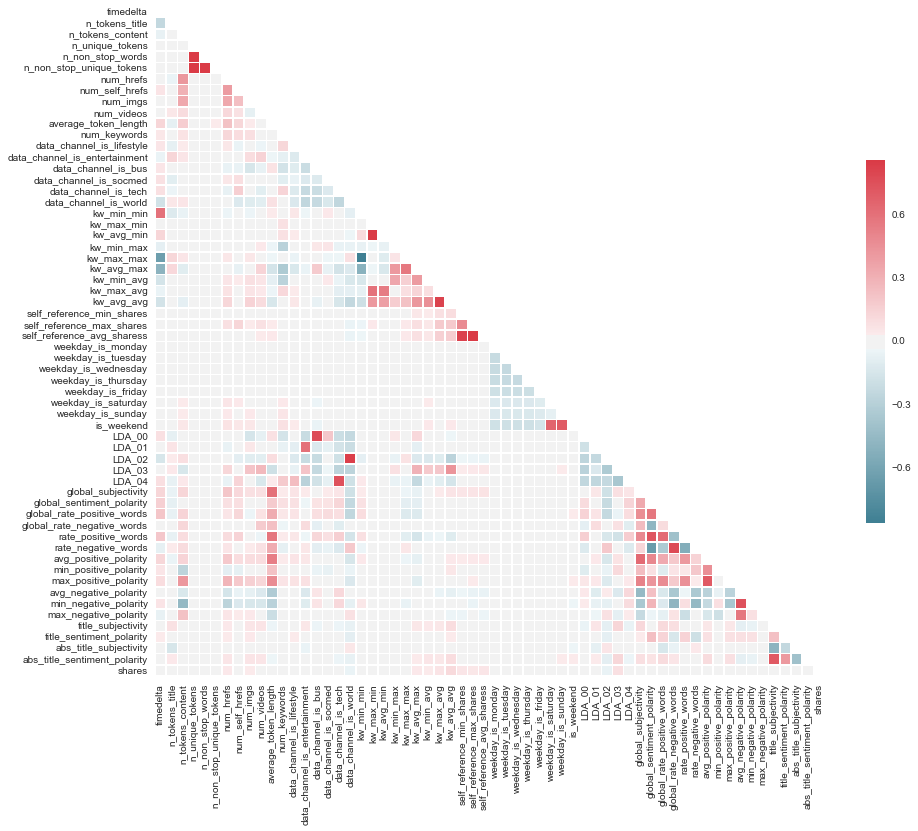

In [8]:
sns.set(style="white")

# Compute the correlation matrix
corr = df.corr()

# Generate a mask for the upper triangle
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(15, 13))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})


# from example found at https://www.kaggle.com/maheshdadhich/strength-of-visualization-python-visuals-tutorial/notebook

##### Remove highly correlated features

Using the correlation matrix above along with judgement we removed the following variables:

- 'url': parsed into new variables
- 'timedelta': not predictive
- 'num_self_hrefs': 
- 'n_unique_tokens':
- 'average_token_length': high correlation with mutliple other variables
- 'kw_min_min': 
- 'LDA_03': LDAs are all related, limited to 0, 1, 2
- 'LDA_04': LDAs are all related, limited to 0, 1, 2
- 'global_subjectivity': high correlation with mutliple other variables
- 'min_positive_polarity'
- 'max_positive_polarity'
- 'min_negative_polarity'
- 'max_negative_polarity'
- 'global_sentiment_polarity'
- 'n_non_stop_words'
- 'n_non_stop_unique_tokens': 
- 'kw_max_min'
- 'kw_avg_min'
- 'kw_min_max'
- 'kw_max_max'
- 'kw_avg_max'
- 'kw_min_avg'
- 'kw_max_avg'
- 'rate_negative_words'
- 'avg_positive_polarity'
- 'self_reference_min_shares'
- 'weekday_is_saturday'
- 'weekday_is_sunday'
- 'self_reference_max_shares'
- 'title_subjectivity'
- 'shares'
- 'rate_positive_words'
- 'abs_title_sentiment_polarity'

In [9]:
# Clasifing Atributes for easy analysis 
dropped_features = ['url','timedelta','num_self_hrefs','n_unique_tokens','average_token_length','kw_min_min','LDA_03','LDA_04',
                    'global_subjectivity','min_positive_polarity','max_positive_polarity',
                    'min_negative_polarity','max_negative_polarity','global_sentiment_polarity',
                    'n_non_stop_words','n_non_stop_unique_tokens','kw_max_min','kw_avg_min',
                    'kw_min_max','kw_max_max','kw_avg_max','kw_min_avg','kw_max_avg',
                    'rate_negative_words','avg_positive_polarity','self_reference_min_shares',
                    'weekday_is_saturday','weekday_is_sunday','self_reference_max_shares','title_subjectivity',
                    'shares','rate_positive_words','abs_title_sentiment_polarity']

df1 = df.drop(dropped_features, axis = 1)


# Compute the correlation matrix
corr = df1.corr()

 #### Correlation matrix of important features

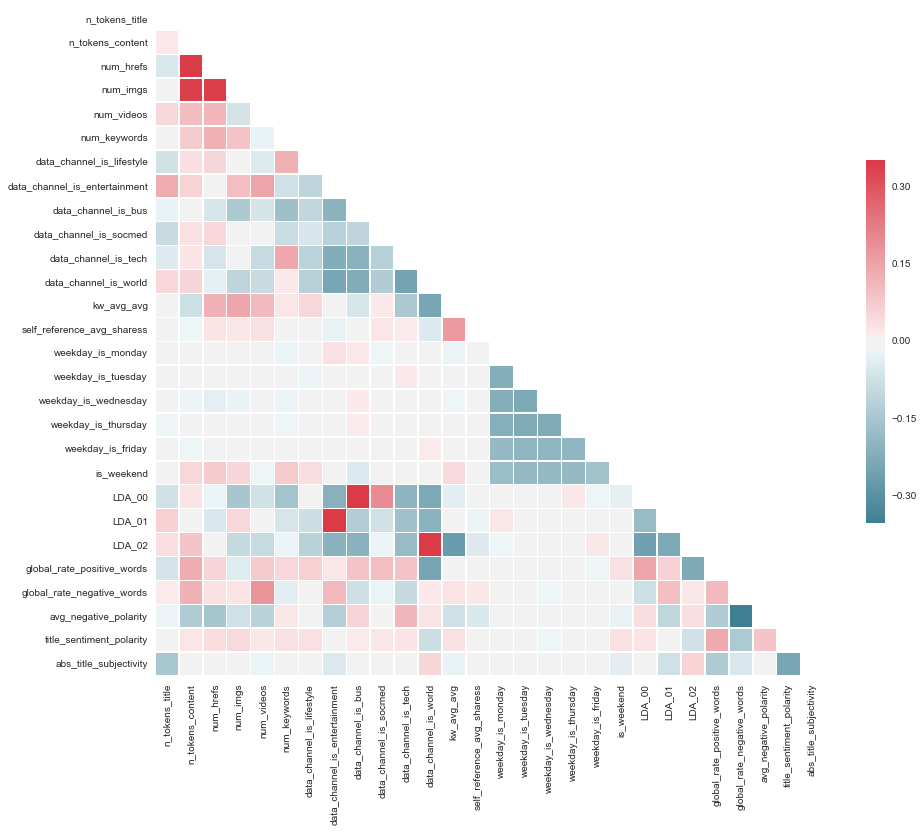

In [10]:
# Generate a mask for the upper triangle
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(15, 13))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)
# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

<a name='intro'></a>  
<a href='#toc'>Return to Table of Contents</a>  
<a name='du.01.t2'></a>
<font color="blue" size=5>3.0 Data Understanding 2</font>
##### 3.a Visualization of important attributes. 

- There are 60 columns in the original data set; we added a few additonal columns based on observed opportunities (e.g., _publication_date_, ...) as explained above. 
    
- From this data set, we did a simple correlation matrix to look for variables that are highly correlated with each other that could be removed with little loss of information.

- With that downselection, we proceeded with additional evaluation of these remaining variables.
    
- we recognize that there is potentially additional opportunity for modeling improvements with some of the remaining variables, and will look to re-expand the data set to further consider that with future work. 


##### Boxplot of important features

/home/mcdevitt/.local/lib/python3.5/site-packages/ipykernel_launcher.py:19: FutureWarning: 
The default value for 'return_type' will change to 'axes' in a future release.
 To use the future behavior now, set return_type='axes'.
 To keep the previous behavior and silence this warning, set return_type='dict'.


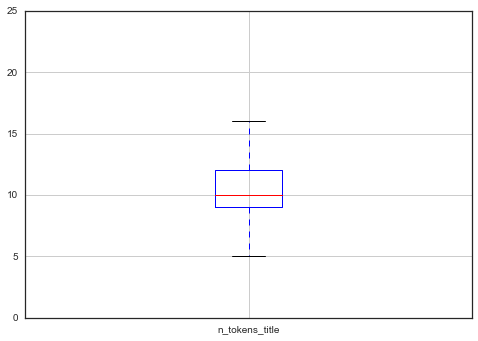

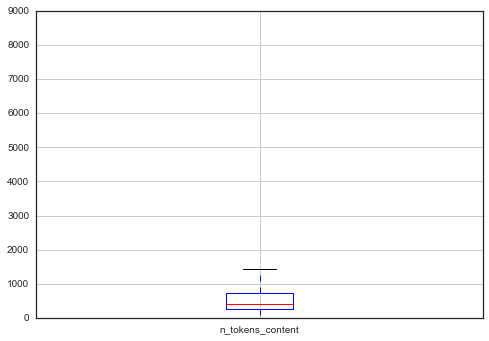

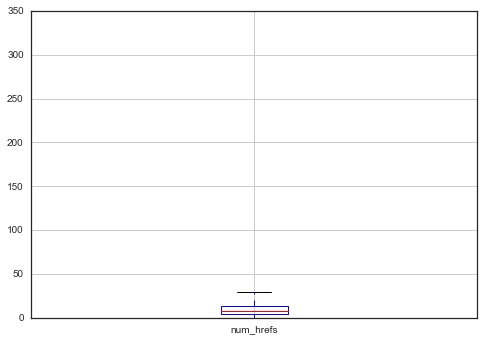

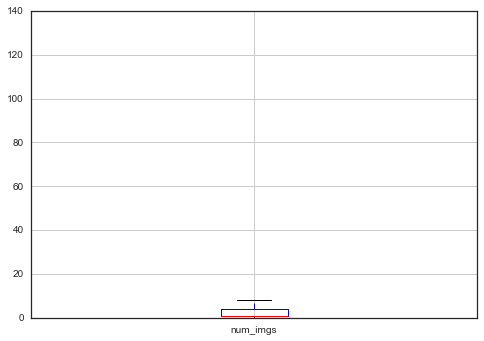

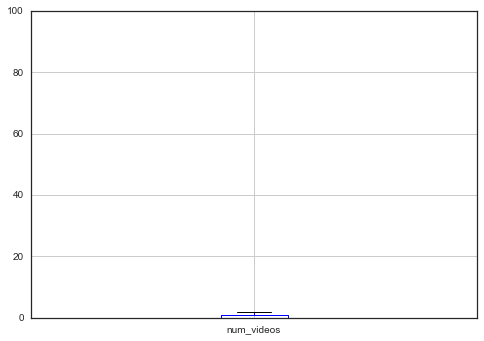

...

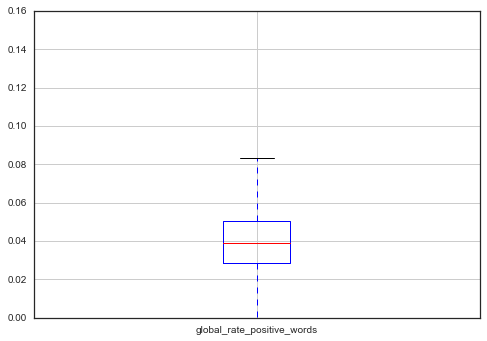

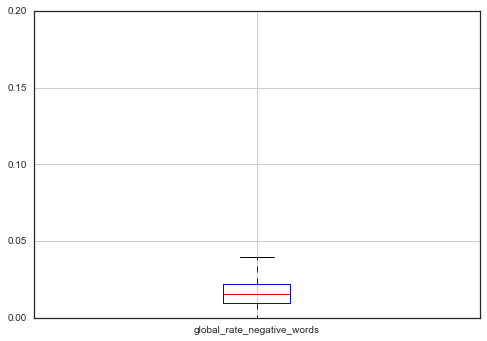

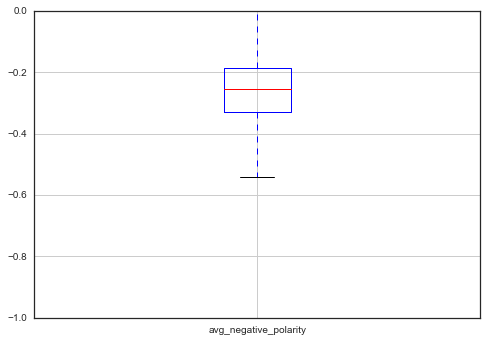

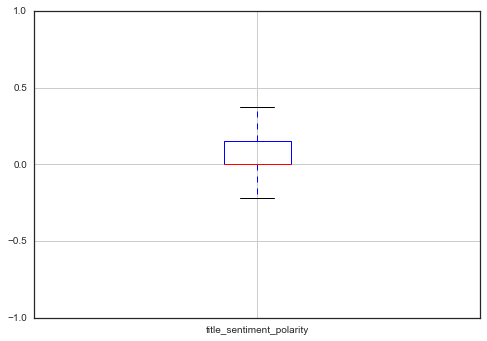

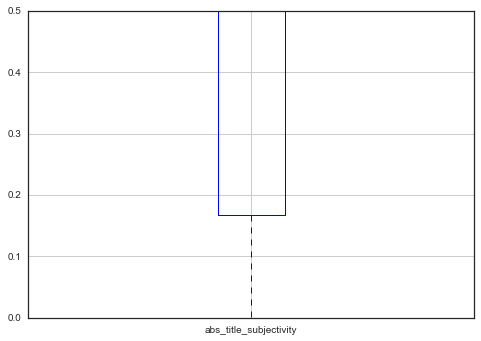

In [11]:
imp_features = ['n_tokens_title',
 'n_tokens_content',
 'num_hrefs',
 'num_imgs',
 'num_videos',
 'num_keywords',
 'kw_avg_avg',
 'self_reference_avg_sharess',
 'LDA_00',
 'LDA_01',
 'LDA_02',
 'global_rate_positive_words',
 'global_rate_negative_words',
 'avg_negative_polarity',
 'title_sentiment_polarity',
 'abs_title_subjectivity']

for var in imp_features:
    df1.boxplot(column = var)
    plt.show()

###### Histogram of important features
       This section contains histograms and cross tabs of several important variables and the popularity rates for each group of variables. The histograms show the distributions of several important variables. 

After looking at the boxplots of these variables it is evident that many are heavily skewed. Before they are used for prediction a log transformation would be beneficial. The following bit of code makes those transformations, creating new variables.

In [12]:
# ---------------------------------
# Log transform variables with high skewness
# ---------------------------------

log_features = ['n_tokens_content',
 'num_hrefs',
 'num_imgs',
 'num_videos',
 'kw_avg_avg',
 'self_reference_avg_sharess',]

df1 = df

# store min value for each column
df_mins = df1[log_features].min()

for column in log_features:
    sk = df1[column].skew()
    if(sk > 1):
        new_col_name = 'ln_' + column
        print (column, sk, new_col_name)
        if df_mins[column] > 0:
            df1[new_col_name] = np.log(df1[column])
        elif df_mins[column] == 0:
            df_tmp = df1[column] + 1
            df1[new_col_name] = np.log(df_tmp)
        else:
            print('--> Log transform not completed :', column, '!!')

n_tokens_content 2.94542193879 ln_n_tokens_content
num_hrefs 4.0134948282 ln_num_hrefs
num_imgs 3.94659584465 ln_num_imgs
num_videos 7.0195327863 ln_num_videos
kw_avg_avg 5.76017729162 ln_kw_avg_avg
self_reference_avg_sharess 17.9140933777 ln_self_reference_avg_sharess


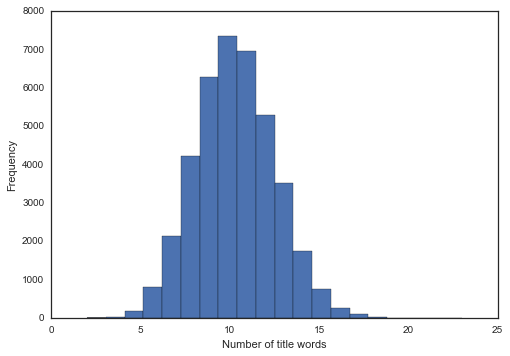

In [13]:
plt.hist(df1['n_tokens_title'], bins = 20)
plt.xlabel('Number of title words')
plt.ylabel('Frequency')
plt.show()

First is the distribution of the number of words contained in the title. This variable is normally distributed and does not require transformation.

- <b>n_tokens_contant:</b>
    'n_tokens_contant' refers to the number of words in the text of the article. It is reasonable to imagine a relationship between the length of an article and the number of shares it receives.

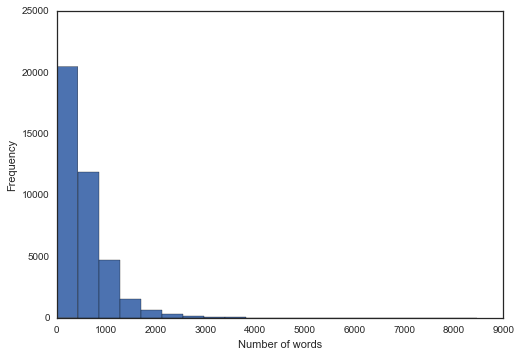

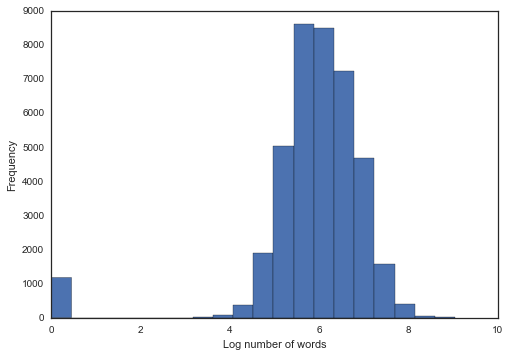

In [14]:
plt.hist(df1['n_tokens_content'], bins = 20)
plt.xlabel('Number of words')
plt.ylabel('Frequency')
plt.show()

plt.hist(df1['ln_n_tokens_content'], bins = 20)
plt.xlabel('Log number of words')
plt.ylabel('Frequency')
plt.show()

The distribution of the untransformed data is heavily skewed. the tranformed distribution shows the improvement.

- <b>df_channel:</b>

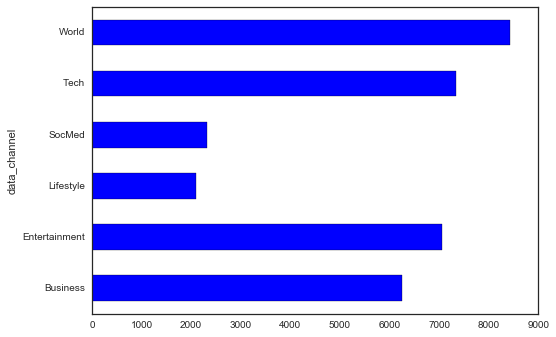

In [15]:
df_channel = df1

df_channel['data_channel'] = np.NaN
condition = df['data_channel_is_lifestyle'] == 1
df_channel.loc[condition, 'data_channel'] = 'Lifestyle'
condition = df['data_channel_is_entertainment'] == 1
df_channel.loc[condition, 'data_channel'] = 'Entertainment'
condition = df['data_channel_is_bus'] == 1
df_channel.loc[condition, 'data_channel'] = 'Business'
condition = df['data_channel_is_socmed'] == 1
df_channel.loc[condition, 'data_channel'] = 'SocMed'
condition = df['data_channel_is_tech'] == 1
df_channel.loc[condition, 'data_channel'] = 'Tech'
condition = df['data_channel_is_world'] == 1
df_channel.loc[condition, 'data_channel'] = 'World'

df_channel = df_channel.groupby(by=['data_channel'])
channel_count = df_channel['data_channel'].count()
_=channel_count.plot(kind='barh', stacked=True, color = ['blue'])

- <b>Global rate of positive words</b>
    Another variable which would logically seem to be important for popularity is the global rate of positive words. This is a rate,so is between zero and one, and it is also normally distributed as seen in the plot below.

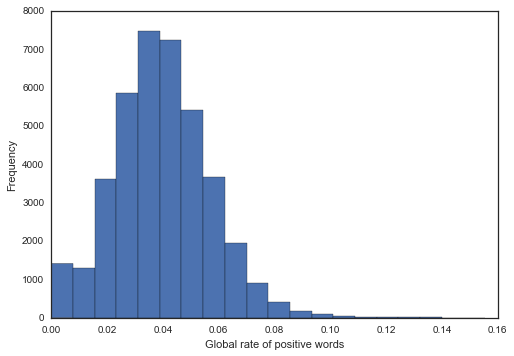

In [16]:
plt.hist(df1['global_rate_positive_words'], bins = 20)
plt.xlabel('Global rate of positive words')
plt.ylabel('Frequency')
plt.show()

##### plots and interpretation of word counts and digital media  

- The data set has features in these 6 broad categories :  
_(ref - see citation reference at beginning of this document)_  
    - Words  
        - Number of words of the title/content  
        - Average word length  
        - Rate of unique/non-stop words of contents
    - Links
        - Number of links  
        - Number of links to other articles in Mashable  
    - Digital Media  
        - Number of images/videos  
    -Time  
        - Day of the week/weekend  
    - Keywords  
        - Number of keywords  
        - Worst/best/average keywords (#shares)  
        - Article category  
    - NLP  
        - Closeness to five LDA topics  
        - Title/Text polarity/subjectivity  
        - Rate and polarity of positive/negative words  
        - Absolute subjectivity/polarity level  
        
As a first exploratory for the relationships among the available variables, we choose to select 9 variables from 4 of the above categories that appear, on the surface, to be highly relevant to the business case objective. 

In this data set, _tokens_count_ refers to the number of words in the published article. As we wish to understand word counts, image counts, and video counts are likely independent predictors of number of eventual shares, to understand their respective utility in a predictive model, we evaluated scatter plots of (1) number of tokens vs. number of images, (2) number of tokens vs. number of videos and (3) number of images vs. number of videos.  
These are shown in below plots.  

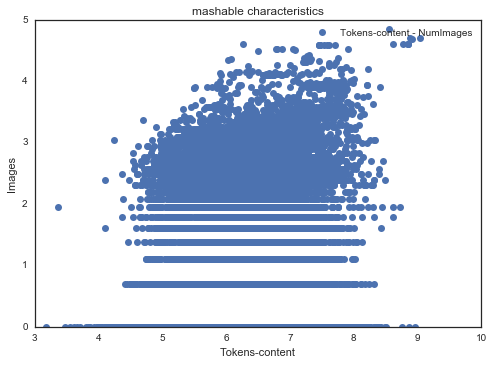

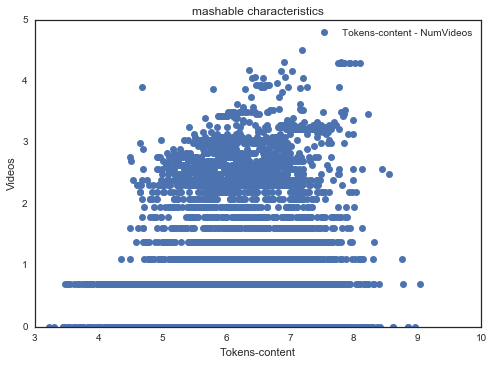

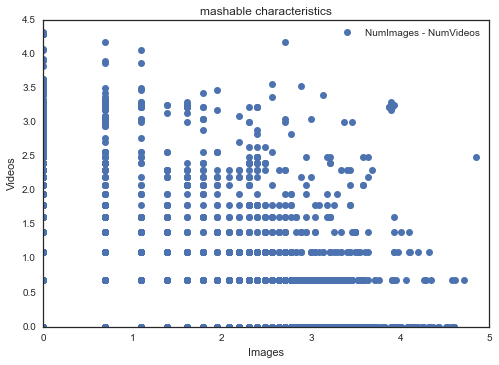

In [17]:
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=
# ... Tokens, Images, Videos plots
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=
import numpy as np

df1.log_n_tokens = np.log(df1['n_tokens_content'])
df1.log_n_imgs = np.log(df1['num_imgs'])
df1.log_n_videos = np.log(df1['num_videos'])

plt.plot(df1.log_n_tokens, df1.log_n_imgs, label = 'Tokens-content - NumImages', linestyle = 'None', marker = 'o')
plt.xlabel('Tokens-content')
plt.ylabel('Images')
plt.title('mashable characteristics')
plt.legend()
plt.show()

plt.plot(df1.log_n_tokens, df1.log_n_videos, label = 'Tokens-content - NumVideos', linestyle = 'None', marker = 'o')
plt.xlabel('Tokens-content')
plt.ylabel('Videos')
plt.title('mashable characteristics')
plt.legend()
plt.show()

plt.plot(df1.log_n_imgs, df1.log_n_videos, label = 'NumImages - NumVideos', linestyle = 'None', marker = 'o')
plt.xlabel('Images')
plt.ylabel('Videos')
plt.title('mashable characteristics')
plt.legend()
plt.show()


We can make the following observations :
- the data values are generally well populated, with high variability   
- there does not appear to be a strong correlation between any of these sets of variables (potentially good news for future predictive model building)  
- we choose to represent these values in ln-transformed space, due to the very wide range of values in each variables domain, and the strong right-skewness of each distribution  

*************** 

#### Plots and interpretation of LDA00 thru 04

#### LDA - Latent Dirichlet allocation  
_(ref : https://en.wikipedia.org/wiki/Latent_Dirichlet_allocation)_  

LDA (in this context) refers to a method by which a body of text can be scored relative to a vocabulary set that is identified with specific topics. A body of text that discusses Machine Learning, for instance, will use vocabulary specific to that topic, and quite different from another text which discusses do-it-yourself home repair. A text can be scored relative to the similarity of a given LDA scale and then compared among other texts for similarity or difference.  
This data set includes measures for 5 LDA topics, identified here as : _LDA_00_, _LDA_01_, ... and _LDA_04_.  
Similar to the above visualization, we choose to review the relative visual correlation among the LDA scores of these articles via scatter plots, this time with each LDA score plotted against _LDA_00_ (vs. _LDA_01_, _LDA_02_, etc.) and a basic histogram of each individual distribution. These are shown in the below plots.  

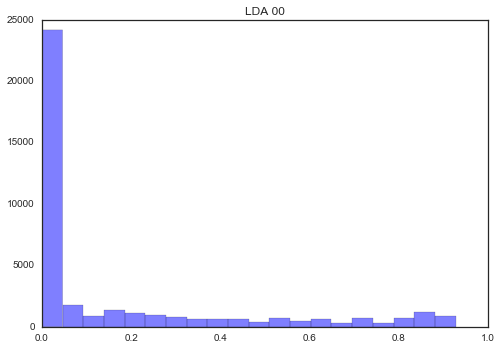

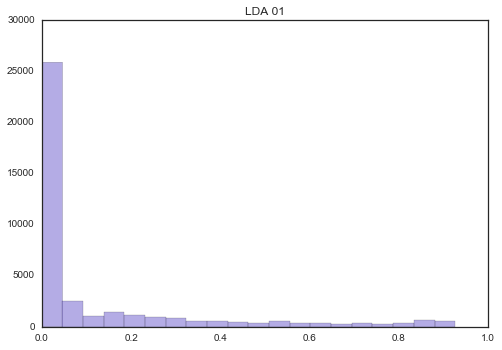

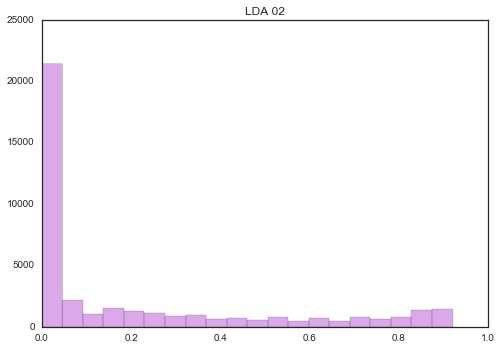

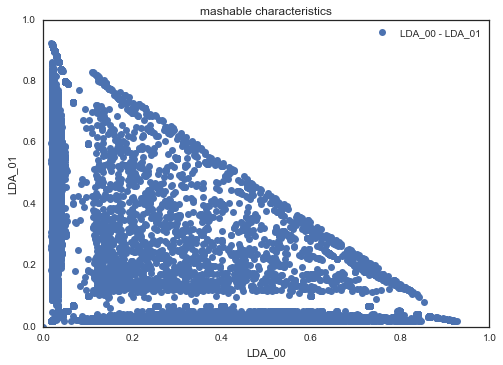

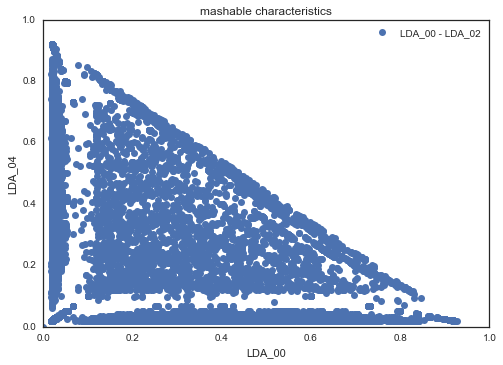

In [18]:
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=
# ... LDA plots
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=

num_bins = 20
plt.hist(df1.LDA_00, num_bins, facecolor='blue', alpha=0.5)
plt.title('LDA 00')
plt.show()

num_bins = 20
plt.hist(df1.LDA_01, num_bins, facecolor='slateblue', alpha=0.5)
plt.title('LDA 01')
plt.show()

num_bins = 20
plt.hist(df1.LDA_02, num_bins, facecolor='mediumorchid', alpha=0.5)
plt.title('LDA 02')
plt.show()

plt.plot(df1.LDA_00, df1.LDA_01, label = 'LDA_00 - LDA_01', linestyle = 'None', marker = 'o')
plt.xlabel('LDA_00')
plt.ylabel('LDA_01')
plt.title('mashable characteristics')
plt.legend()
plt.show()

plt.plot(df1.LDA_00, df1.LDA_02, label = 'LDA_00 - LDA_02', linestyle = 'None', marker = 'o')
plt.xlabel('LDA_00')
plt.ylabel('LDA_04')
plt.title('mashable characteristics')
plt.legend()
plt.show()

We can make the following observations :  
- Each of the historgrams shows a very high frequency at or near the zero axis but also a reasonably sized portion of each population widely distributed along the 0 - 1 axis range of the LDA score. This is (a) expected, and (b) potentially a very positive aspect of the data set for future analysis. This is expected because there are a wide range of topics published on the _mashable_ web-site and each range of topics is expected to have disparate LDA scores. This is potentially useful because it provides a wide-ranging set of diverse measures which may prove to be predictive in the eventual business objective evaluation.  
- Each of the scatter plots shows (of which only 2 are included here, as the remaining are all very similar in nature visually) that there is little correlation between any of two LDA scores. This is also expected (again due to the wide range of _mashable_ topics), but provides visual confidence that the data values provided have good domain range and are likely sufficiently non-correlated as to be useful in model building.

#### Plots and interpretation of Keywords  and Mashable-referenced hyperlinks

The data set contains an interesting feature idea for this evaluation. The links that are embedded in each article, prior to publication, are evaluated for the keywords in those links and the number of social media shares associated to those embedded links. These are then scored relative to the success rates of the each of the keywords on a best/avg/worst basis. This is an interesting concept, in essence, to use previous related social media share success / failure keywords as an estimator of a to-be-published article. Since this is an interesting, and potentially useful, feature in this data set, we decided to explore with a simple data view to visualize the relationship between _keywords_avg_max_ and _self_reference_shares_, to verify that the distributions are understood and also that there is non-dependency between features such as _kw_avg_max_ and _self_reference_shares_.  

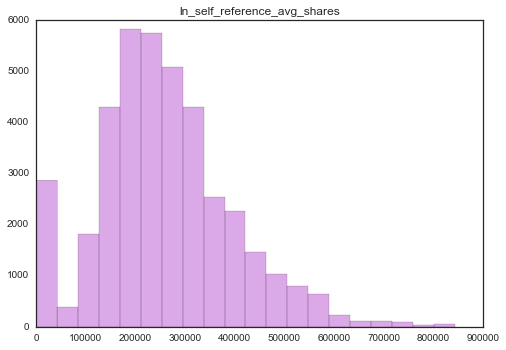

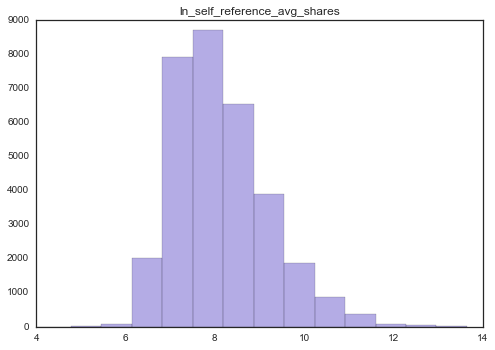

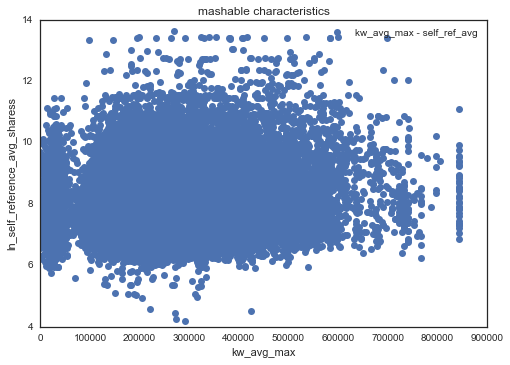

In [19]:
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=
# ... Keywords visualizations
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=
import numpy as np

num_bins = 20
plt.hist(df1.kw_avg_max, num_bins, facecolor='mediumorchid', alpha=0.5)
plt.title('ln_self_reference_avg_shares')
plt.show()

df1.log_self_share = np.log(df1['self_reference_avg_sharess'] + 1)
axes = plt.gca()
axes.set_xlim([4,14])
num_bins = 20
plt.hist(df1.log_self_share, num_bins, facecolor='slateblue', alpha=0.5)
plt.title('ln_self_reference_avg_shares')
plt.show()

axes = plt.gca()
axes.set_ylim([4,14])
plt.plot(df1.kw_avg_max, df1.log_self_share, label = 'kw_avg_max - self_ref_avg', linestyle = 'None', marker = 'o')
plt.xlabel('kw_avg_max')
plt.ylabel('ln_self_reference_avg_sharess')
plt.title('mashable characteristics')
plt.legend()
plt.show()

From above plots, we observe the following :  
- The histograms shows a reasonably sized portion of each population distributed along the full domain range of each feature. This is a positive characteristic of the data set for future analysis.   
- The scatter plots shows that there is little correlation between the two features, again identifying that these features are likely sufficiently non-correlated as to be useful in model building.  

<a name='intro'></a>  
<a href='#toc'>Return to Table of Contents</a>  

<a name='me.01.t1'></a>

<font color="blue" size=6>  4. Modeling and Evaluation 1</font>

# TODO lot of clean-up here

***

 * __Train__     (1):  
     - Perform cluster analysis using several clustering methods (adjust parameters).  
 * __Eval__      (2):  
     - Use internal and/or external validation measures to describe and compare the clusterings and the clusters
     - How did you determine a suitable number of clusters for each method ?   
 * __Visualize__ (3):
     - Use tables/visualization to discuss the found results.  
     - Explain each visualization in detail.  
 * __Summarize__ (4):  
     - Describe your results.  
     - What findings are the most interesting and why ?  
     
***


Model & Eval 1 (Train & Adjust) --- run multple models
1.1 -t-sne
1.2 kmeans
1.3 - spectral
1.4 -hierarchical

Model & Eval 2 (Evaluate & Compare) --- pick number of clusters, compare silhouettte scores
2.1 - kmeans
2.2 - spectral
2.3 -hierarchical

Model & Eval 3 (Visualize) -- visualize, cluster maps 3-way
3.1  -kmeans
3.2 - spectral
3.3 -hierarchical

Model & Eval 4 (Summarize) - analysis, identify meaning of each cluster 
4.1  -kmeans
4.2 - spectral
4.3 -hierarchical
4.4 - Compare across models


### a. Train and Adjust parameters

The base data set from which we are starting has appoximately 35 features. The data set was cleaned and pre-processed for analysis, as outlined in the prior sections of this report - missing values identified, outliers dispositioned, and also all features re-scaled to standard normal distribution.  

In the nominal data set some features are naturally scaled from 0 to 1 (real values), such as the Latent Dirichlet Allocation (LDA) measures, while other features are measured in the range of 0 - 800,000 ! (e.g. number of shares in social media context). Since both dimensionality reduction and cluster analyses depend on relative magnitudes, all features were mapped to standard normal distribution to provide even weighting of all features in the mapping / clustering processes. The binary features (e.g., is_data_channel_technology) are all retained as binary 0/1 valued features and one-hot encoded to similarly support evenly distributed distance evaluations among such categorical features.  

Early efforts in which we attempted to use the cleaned data set and perform cluster analyses yielded results which did not provide straightforward interpretations of the clustering results. Visually, the cluster maps did not provide well-organized presentations of clusters and the silhouette and distortion metrics were generally disorganized as a function of the number of clusters - these metrics were not smooth functions that indicated in any clear sense an optimal or even preferred number of clusters from those analyses. Methods attempted at that point included k-means, DBSCAN, and Spectral Clustering.

* #### t-Distributed Stochastic Neighbor Embedding  

Thus, we were motivated to explore dimensionality reduction as a means to simplify the data set that we presented to the clustering algorithms. Evaluating choices for dimensionality reduction we considered Principal Components Analysis (PCA) and t-Distributed Stochastic Neighbor Embedding (t-SNE). Between the two methods, we decided to evaluate t-SNE.  
 
 - t-SNE is a recently developed method (2008)<sup><a href="#fn2" id="ref2">2</a></sup> that provides a means of dimensional reduction and is becomg popular as a visualization tool for high dimensional data.  
     - The method is a probablistic method of mapping distance distributions from the high dimensional space to a lower dimensional space. In contrast to PCA, the t-SNE approach can provide differing results on successive solutions on the same data set.  
     - It is somewhat computationally expensive. The proceesing time can be cumbersome on large data sets. For our case, we chose to use 35% of the ~40,000 rows and 35 features. The processing time for a 2-dimensional mapping varied from 200 seconds (perplexity = 5) to 46 minutes (perplexity = 1000). This time duration was supportable with a reasonable compromise by sampling 1/3 of the data set. The 35% sample from the full data set was selected as a random sample. The distributions of the features in the sampled set were similar to the distributions in the nominal full data set. This data set does not have features that are heavily unbalanced, so random sampling within this data produces samples with similar distributions. 
     - multiple runs of the t-SNE algorithm with different samples produced t-SNE maps with visual similarities, and produced very consistent measures of KL-divergence from run to run. Thus, sampling within the set did not appreciably influence the produced mapped data.
     - the controlling parameter in the sci-kit learn implementation of t-SNE is the _perplexity_ parameter. _Perplexity_ in t-SNE is the parameter that functions to set the number of nearest neighbors in the mapped space. The authors of the method suggest that perplexity values in the range of 5 to 50 are typically used. For our evaluation, we experimented with _perplexity_ in the range of 5 to 1000. Kullback-Leibler divergence is the provided output measure in the sci-kit learn model and is recommended as a means to monitor the relative improvment of one t-SNE mapping in comparison with others as a function of the perplexity. The K-L divergence acts in this case as a measure of the cross-entropy between the provided feature set and the t-SNE mapped distribution.<sup><a href="#fn2" id="ref2">2</a></sup> In our analysis, the K-L divergence continued to decrease with increasing perplexity without achieving a demonstrated minimum, although the curve of K-L divergence plotted vs. perplexity does exhibit an elbow with perplexity in the 200 - 400 range. In addition, the plot of processing time vs. perplexity shows an essentially linear relationship; thus increasing perplexity comes with a consequent cost to process time. Visually, the t-SNE mappings in 2-D space appear to generate visually separable clusters and approximately the same number of visual clusters. We estimate that using perplexity in the range of 75 - 400 for this data set provides reasonably consistent results for the purposes of this evaluation.  
     - in any case, once computed, the t-SNE maps for all values of perplexity were saved and are available for use in the subsequent clustering applications  
     - since the original data set was sampled at 35% of the full data set, the indices of the sampled rows were retained and written back to the saved data set of t-SNE vectors, so that the identical rows could be matched from the full data set during the later evaluation to be completed after the clustering analyses  
     

#### Figure XX - K-L Divergence and Processing Time in t-SNE mapping with increasing perplexity

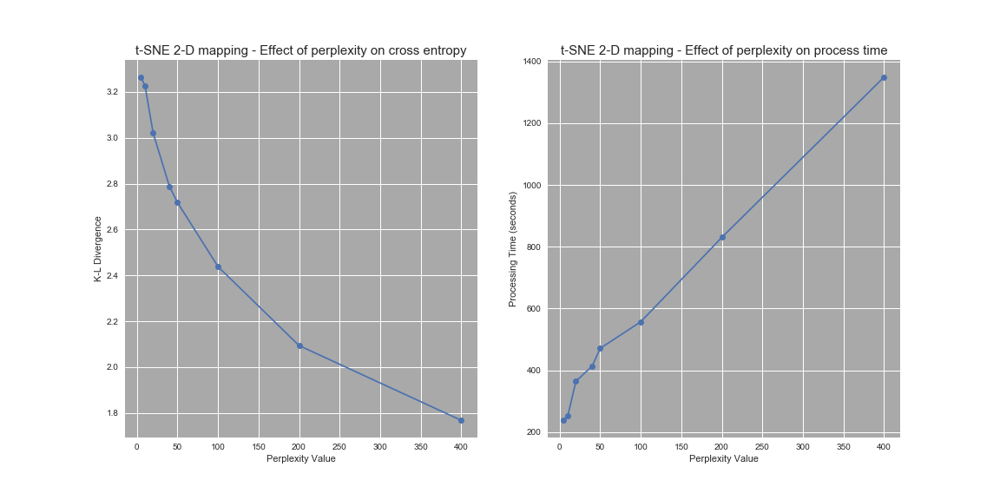

In [20]:
Image("./plots/tsne/t_sne_divergence_process_time.png")

#### Figure XX - Examples of 2D mapping in t-SNE space (t1 vs. t2) at various values of perplexity

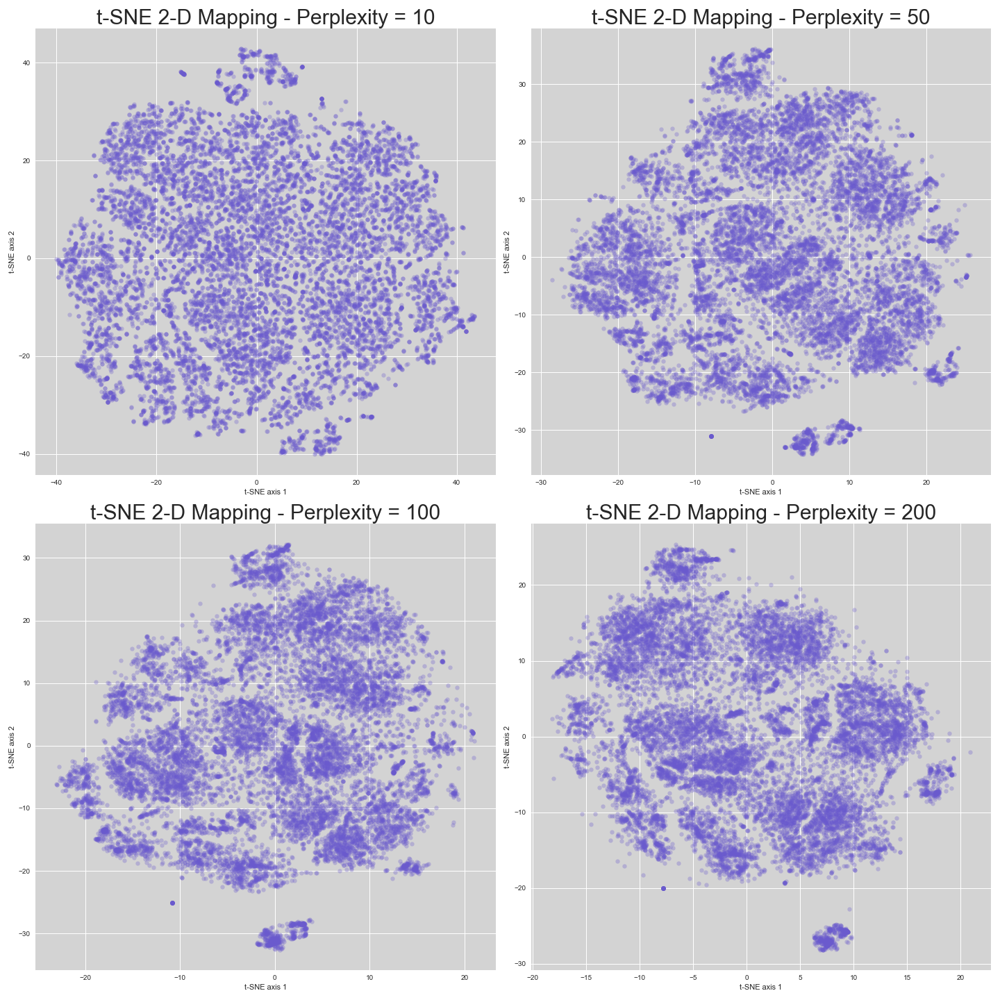

In [21]:
Image("./plots/tsne/t_sne_clusters_all_together.png")

#### Clustering  

Having completed the t-SNE mapping, the next step in the process was to apply different clustering methods for evaluation of appropriate clustering results.

In our evaluation, we chose to evaluate with  

* __k-means clustering__  
* __spectral clustering__  
* __hierarchical clustering__   
    
These three methods have fundamental differences and we assessed that they can provide different opportunities to identify different resulting cluste definitions.

#### 1.2 K-Means Clustering  (Training)
     
- the process for implementing the k-means was as follows :  
   - read into memory the stored t-SNE vectors from the previously completed t-SNE mapping, along with the reference indices 
   - initiate the k-means clustering from the sci-kit learn library  
   - the initialization method chosen is 'kmeans++' as that can improve convergence time  
- the number of clusters was evaluated for 2 - 20 clusters
- the results presented here correspond to the t-SNE 2-D vectors associated to perplexity value of 100
    

#### 1. 3 SpectralClustering  (Training)
     
- the process for implementing the spectralclustering is similar to the process as was used for k-means :  
    - read into memory the stored t-SNE vectors along with the reference indices  
    - initiate the spectralclustering from the sci-kit learn library  
    - the affinity method chosen is 'nearest_neighbors' 
- the number of clusters was evaluated for 2 - 20 clusters
- the results presented here correspond to the same t-SNE 2-D vectors associated to perplexity value of 100 as was used for the k-means clustering. This provides an opportunity to do a basic comparison of the different cluster methods on the same data set with identical dimensional reduction.

#### K-Means Clustering  (Evaluation)

- the results of the clustering were evaluated using the _silhouette_ and _inertia_ scores
- the _silhouette_ score provides a measure of the cohesion of the observations within their assigned cluster relative to their separation from the observations in the neighboring clusters. The higher the silhouette value (to a maximum value of 1) represents a more preferred clustering.  For this evaluation, we plotted the average silhouette score for each _K_ value for the range of clusters. From the plot below, the silhouette score indicates that a clustering of 7 clusters provides the highest silhouette score.
- the _inertia_ score provides the sum of squared distances of each value to its assigned cluster centroid. A lower _inertia_ score indicates lower variance within the set of clusters. As this is a continaully decreasing function relative to the number of clusters, typical practice is to identify an 'elbow' in the _inertia_ vs. number of clusters plot as an indicator of optimal number of clusters. That method is used here to identify that approximately 7 clusters (or slightly greater) can be considered the range of appropriate number of clusters.  

- Thus, by standard measures, appropriate choices for number of clusters from this k-means clustering analysis is 7.  

The 7 cluster set will be generated, visualizations provided, and results analysed in subsequent sections of this report.

#### Fig XX - Silhouette, Inertia, and Processing Time for K-Means clustering

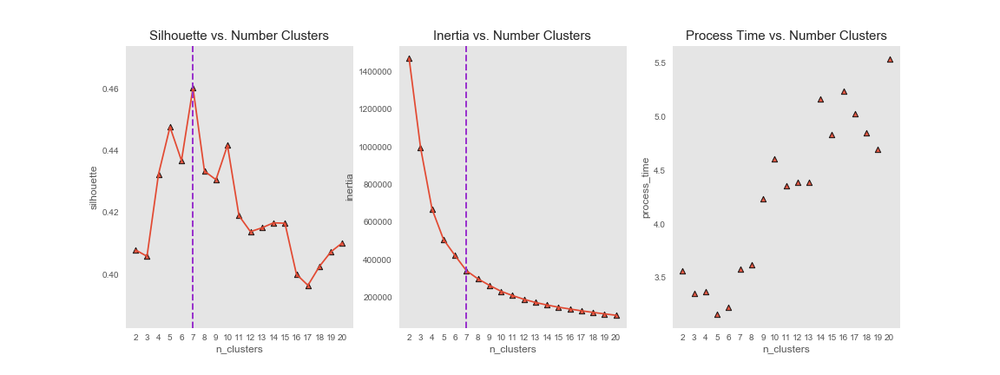

In [22]:
Image("./plots/kmeans/cluster_kmeans_number_of_clusters_eval.png")

#### Spectral Clustering  (Evaluation)

- the results of the clustering were evaluated using the _silhouette_ scores
- as stated above, the _silhouette_ score provides a measure of the cohesion of the observations within their assigned cluster relative to their separation from the observations in the neighboring clusters.  

For this evaluation, we plotted the average silhouette score for each _K_ value for the range of clusters. From the plot below, the silhouette score indicates that a clustering of 7, 8, 9, or 10 provides the highest range silhouette scores; the local maximum is observed at 8 clusters.  

Thus, by _silhouette_ score, appropriate choices for number of clusters from this spectral clustering analysis is 7 to 10 clusters; we will evaluate the analysis with 8 clusters as that provides local maximum in _silhouette_ score.

#### Fig XX - Silhouette score and Processing Time for Spectral clustering

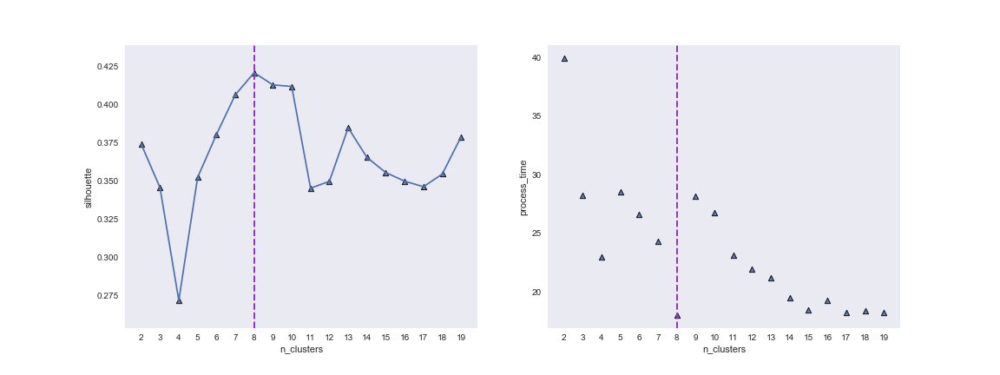

In [23]:
Image("./plots/spectral/cluster_spctrl_number_of_clusters_eval.png")

### 1.4 Hierarchical Clustering

<p>Under this section we will build 3 hierarchical models based on the linkage methods (Ward, Complete, Average). We will compare the 3 models behaviour, identify any patters within.

To identify number of clusters needed we will be using <b>dendrogram</b>. 

Once the models are run, we will look into summary table for silhoutte value and processing time. 

<b><u>Steps</u></b>:
The process for implementing the hierarchical clustering was as follows :

1. Read into memory the full data set
2. Read into memory the stored t-SNE vectors along with the reference indices
3. Conduct a join on the 2 data sets to match rows of the t-SNE vectors to their corresponding rows of the feature data
4. Create dendogram to identify optimal clusters under each method.
5. Initiate the hierarchical clustering from the sci-kit learn library for 3 linkage methods  
    - ward
    - complete
    - Average

<b><u>Evaluation</u></b><br>
* The results presented here correspond to the t-SNE 2-D vectors associated to perplexity value of 100<br>
* The results of the clustering were evaluated using the silhouette scores and processing time.<br>
* The silhouette score provides a measure of the cohesion of the observations within their assigned cluster relative to their separation from the observations in the neighboring clusters. The higher the silhouette value (to a maximum value of 1) represents a more preferred clustering.

#### Fig XX - Dendogram and cluster formation , linkage type = Average

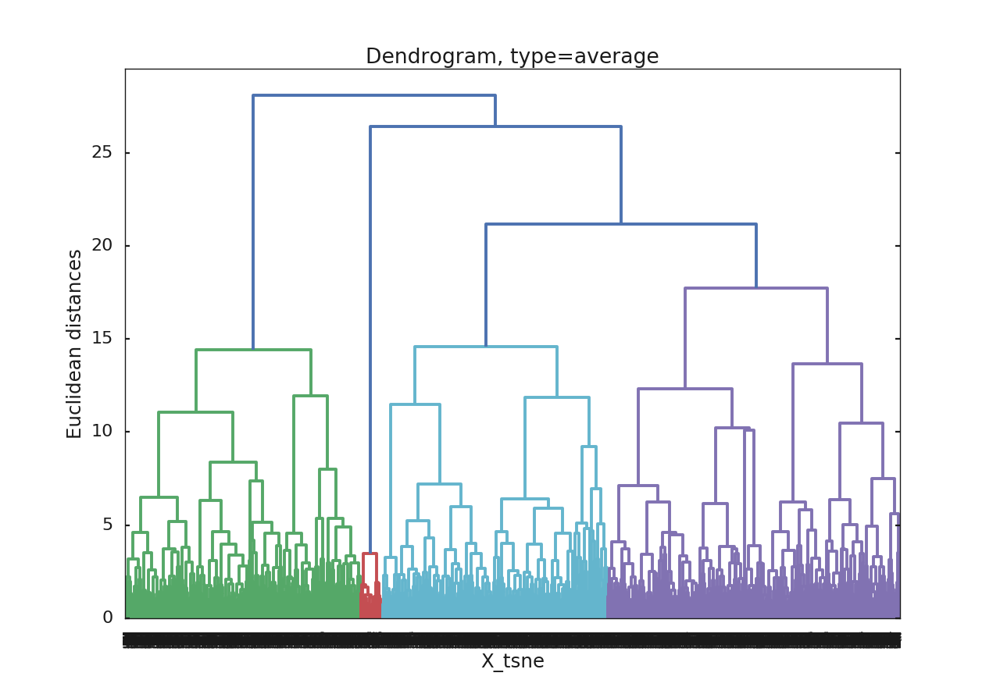

In [6]:
Image("./plots/hierarchical/dendrogram_average.png")

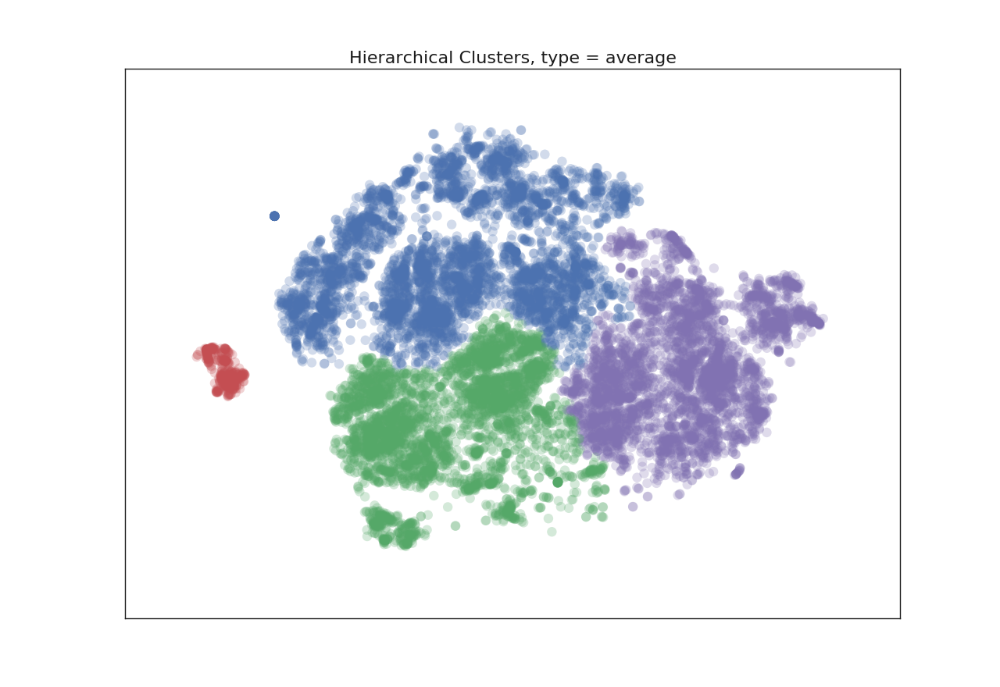

In [7]:
Image("./plots/hierarchical/hc_average_eval.png")

#### Fig XX - Dendogram and cluster formation , linkage type = Ward

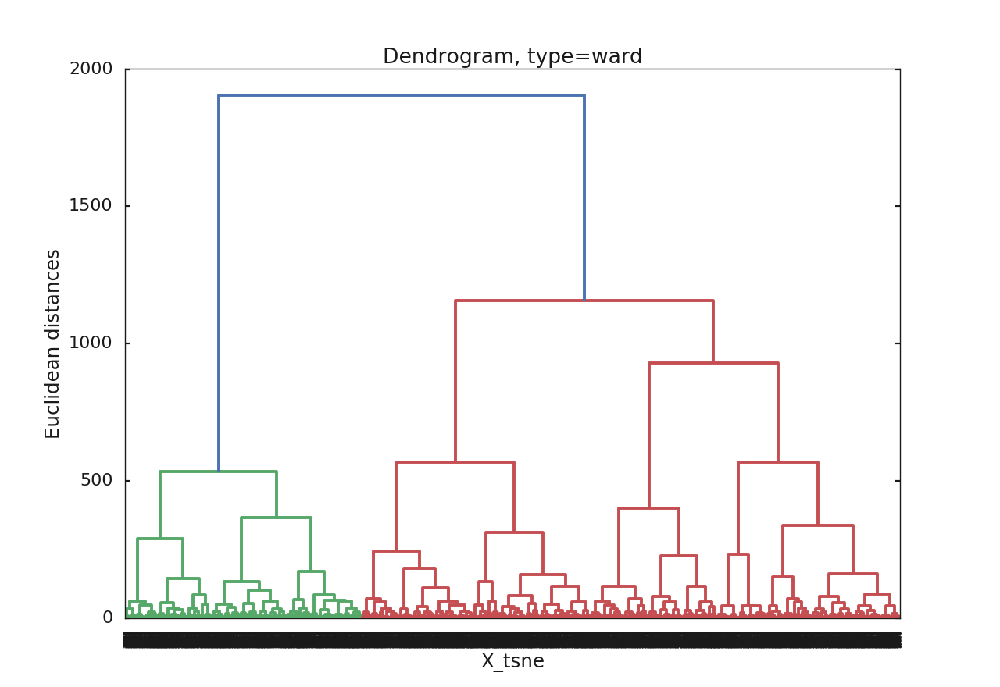

In [8]:
Image("./plots/hierarchical/dendrogram_ward.png")

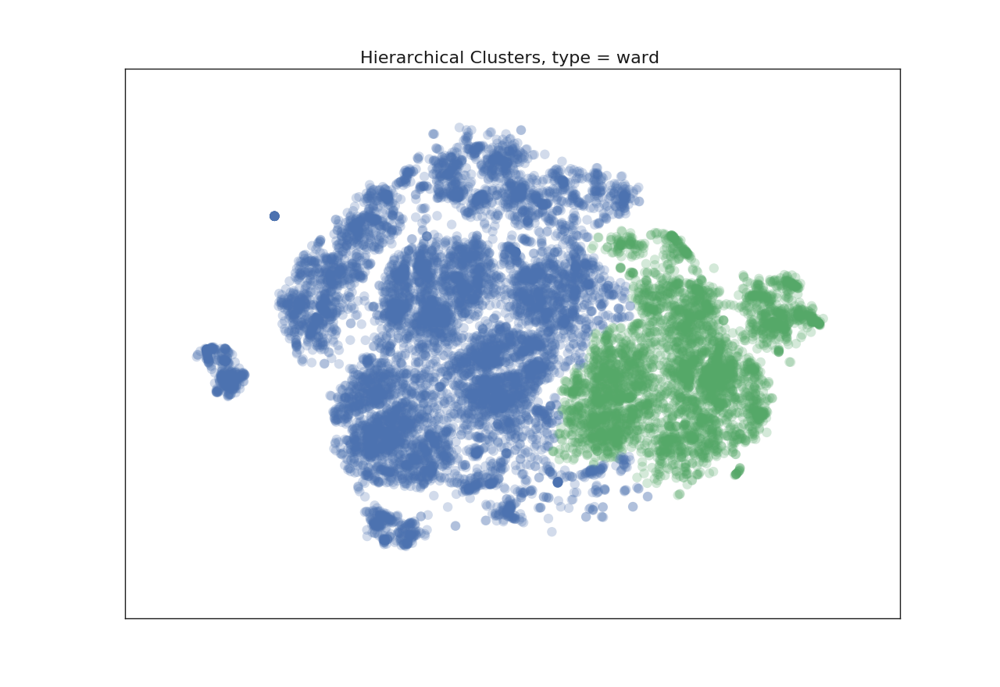

In [9]:
Image("./plots/hierarchical/hc_ward_eval.png")

#### Fig XX - Dendogram and cluster formation , linkage type = Complete

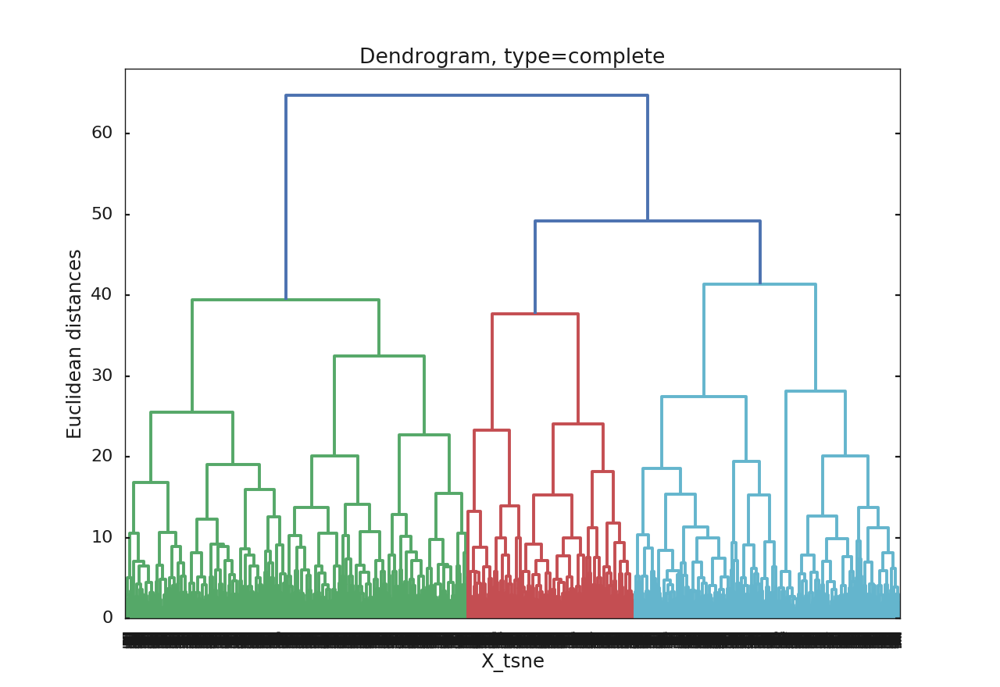

In [10]:
Image("./plots/hierarchical/dendrogram_complete.png")

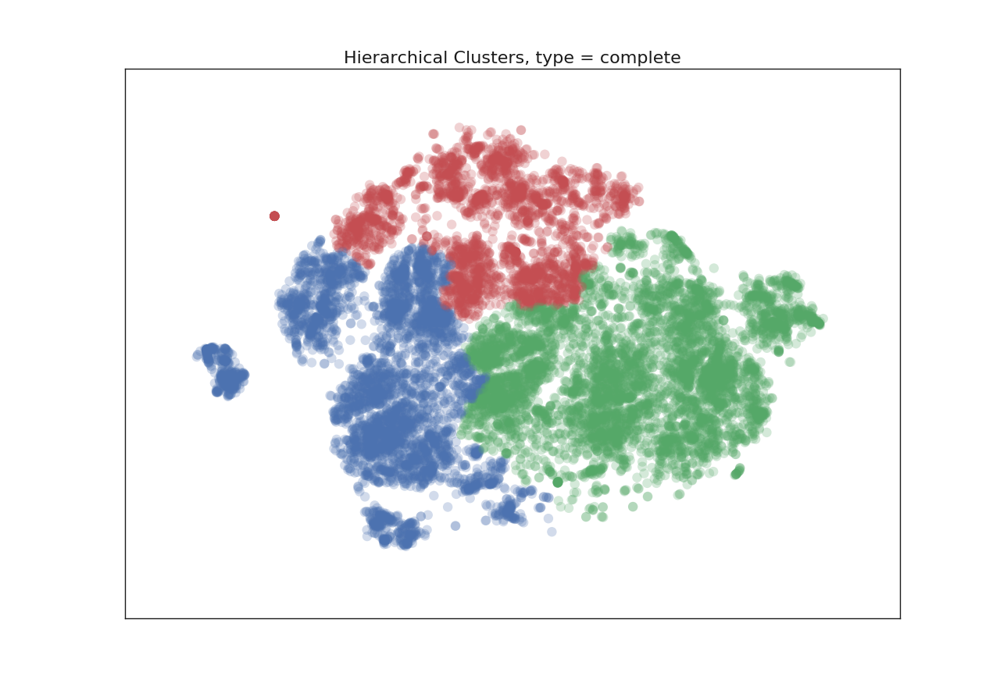

In [11]:
Image("./plots/hierarchical/hc_complete_eval.png")

<a name='intro'></a>  
<a href='#toc'>Return to Table of Contents</a>  

<a name='me.01.t2'></a>

<font color = "blue" size = 6> 5. Modeling and Evaluation 2</font>

// TODO missing 5.1, 5.2

### 5.3 Compare hierarchical models

Using the optimal cluster values, Let us run 3 different models based of linkage and tabluate the data.

#### Table XX - Evaluation Marrix

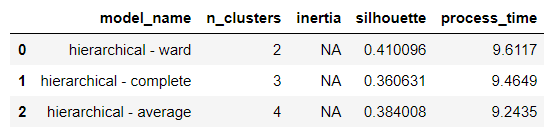

In [12]:
Image("./plots/hierarchical/hc_evaluation_matrix.png")

# TODO: write words of above matrix

<a name='intro'></a>  
<a href='#toc'>Return to Table of Contents</a>  

<a name='me.01.t3'></a>

<font color = "blue" size = 6> 6. Modeling and Evaluation 3: Visualize results</font>

### 6.1 K-Means Clusters - Visualize  

* To evaluate the resulting clusters for each of the k-value = 7 clusters the following approach is taken :  

    - re-join the feature data set to the cluster identification regions from the k-means analysis for comparison of the features with the mapped cluster labels  
    - construct visual interpretation aid of a 3-plot set for each feature as shown in below figures. Each 3-set of plots includes the following :  
        - left hand map is a spectrum map of that feature onto the t-SNE 2-D vector space, the color scale represents the magnitude of each point of the feature in that space,
        - the center plot is a set of box-whisker plots of the same feature, where each boxplot is associtaed to each of the cluster labels. In addition to the boxplots which include the quartile definitions as the box boundaries, the population mean in each cluster is represented on the boxplot chart in (small) white text.
        - the right hand map is the representation of the cluster labels - differentiatied by each color region - of the clusters as visualized in the t-SNE 2D space
        
   - the 3-plot set can be viewed together for each feature to understand how that feature's relative values are distributed across the clusters, and allows to visualize 
   - examples from 4 of the features (LDA_00, LDA_01, LDA_02, LDA_03, and LDA_04) are shown in the following set of plots (Figures XX --> XX_5)  
   
* These plots show the following relationships :  
    - LDA_00 high values are associated with Cluster 3.
    - LDA_01 high values are associated with Cluster 6.
    - LDA_02 high values are associated with Cluster 5.
    - LDA_03 high values are associated with Cluster 2.
    - LDA_04 high values are associated with Clusters 1 & 4.
    
* Similarly, an observation about relative participation of each feature in each of the clusters was identified and used in the subsequent interpretations of the clusters.
   


***

#### Fig X - LDA_00 distributions in K-Means cluster space  

* Cluster 3 is associated to high values of LDA_00 (correlated to Business Channel)

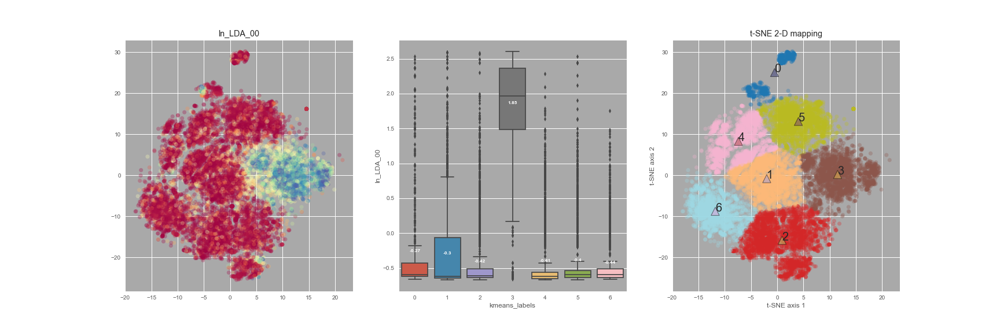

In [24]:
Image("./plots/kmeans/cluster_kmeans_3way_preplx_100__7clstrsln_LDA_00.png")


***

#### Fig X - LDA_01 distributions in K-Means cluster space  

* Cluster 6 - associated to high values of LDA_01 (correlated to Entertainment Channel)

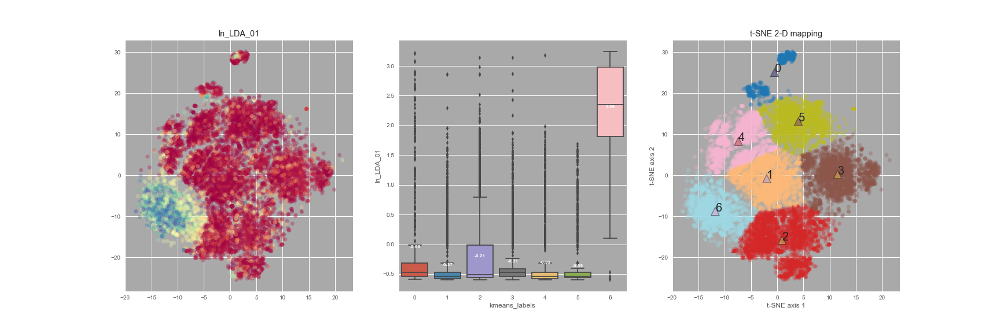

In [25]:
Image("./plots/kmeans/cluster_kmeans_3way_preplx_100__7clstrsln_LDA_01.png")

***  

#### Fig X - LDA_02 distributions in K-Means cluster space  

* Cluster 5 - associated to high values of LDA_02 (correlated to World Channel)

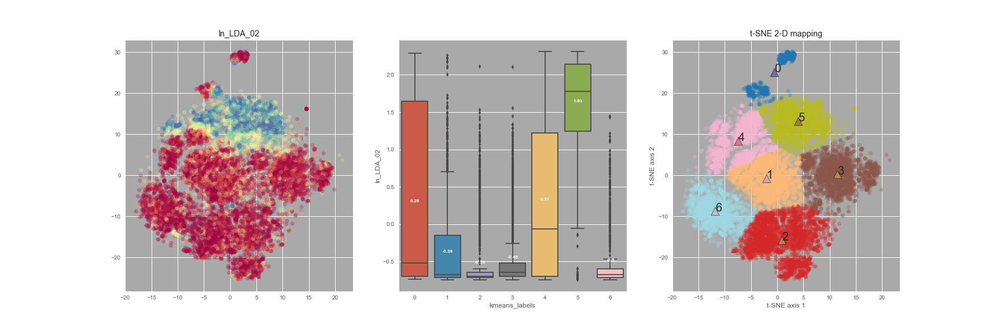

In [26]:
Image("./plots/kmeans/cluster_kmeans_3way_preplx_100__7clstrsln_LDA_02.png")

***  

#### Fig X - LDA_03 distributions in K-Means cluster space  

* Cluster 2 - associated to high values of LDA_03

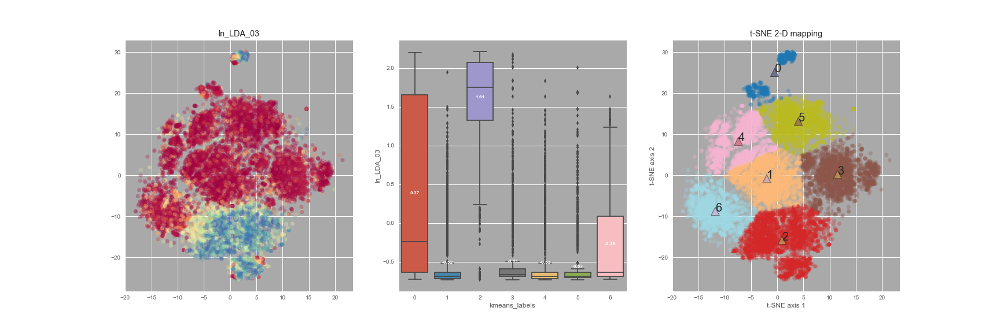

In [27]:
Image("./plots/kmeans/cluster_kmeans_3way_preplx_100__7clstrsln_LDA_03.png")

***  

#### Fig X - LDA_04 distributions in K-Means cluster space  

* Clusters 1 & 4 - associated to high values of LDA_04 (correlated to Technology Channel)

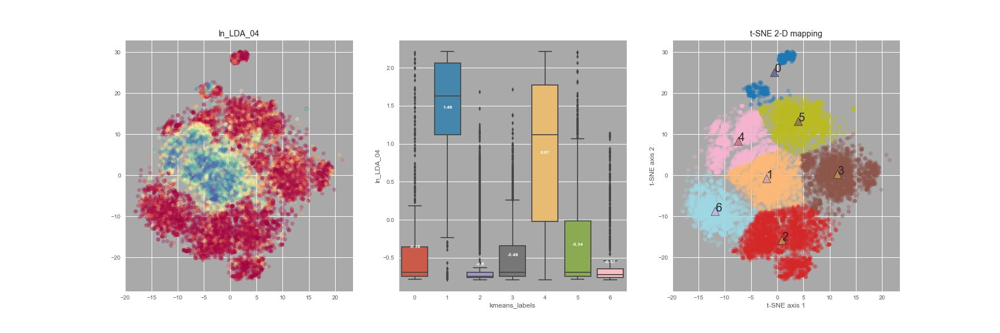

In [28]:
Image("./plots/kmeans/cluster_kmeans_3way_preplx_100__7clstrsln_LDA_04.png")

- The 3-plot sets above aid in identifying the assocation of each feature relative to the cluster regions and 

To further understand the cluster relationships, an additional view is presented. For each cluster the mean value of each feature in that cluster was determined, the standard deviation of those means, and a z-score of each mean relative to other means in that cluster were compared. The goal was not to assess these z-scores for statistical signficantly different means, but rather as a method to identify in a consistent way the relative participation of each feature in each cluster. The goal is to identify the few most (both positively and negatively) impactful features in defining the cluster characteristics. The median of each cluster, or some other statistic, could have also been used for this purpose. For the clusters developed for this data set, means and medians provide essentially the same view of the major contributors to a cluster characterization.

The plots below show these distributions of means for each feature in each of the clusters developed from the above k-means application.

As an example, we can make the following observations of the clusters based on these plots (and a detailed examination of the underlying values in a data table)  

* Cluster 01  
    - LDA_04 (correlated to Technology Channel) is strongest definer
    - several references to _positive_ sentiment rank near the top contributors
    - All other LDA scores are negatively indicated in this cluster - there is a strong negative relationship to the other data channels (Business, Entertainment, World, and SocialMedia). In other words, this cluster is uniquely associated to the Technoglogy channel and also has appreciation for article content with stronger positive sentiments
    
* Cluster 04
    - LDA_04 and LDA_02 are strong participants in this cluster
        . LDA_04 is correlated to the Technology Channel
        . LDA_02 is correlated to the World Channel
        . 
    - Measures related to referencing other articles from within the mashable ecosystem (ln_self_reference_sharess)vare minimally used
    - Measures related to high use of keywords from within these articles is negatively associated to this cluster (kw_min_max and kw_avg_max)
    Thus, we can interpret this to be a cluster defined by an intersection or association of appreciation to World and Technolgy related content and with low reliance and interest on pursuing to other (even related) articles within the mashable site
    
Similary, an interpretation was completed for each cluster based on the relative measure of feature means distribution within each cluster.

As will be shown in subsequent sections, this exercise was repeated for each of the clustering methods deployed. A synopsis of relevant clusters from the overall analysis will be presented in the summary section.



***  

#### Fig X - Relative participation of each feature in each cluster (K-Means)

*** 

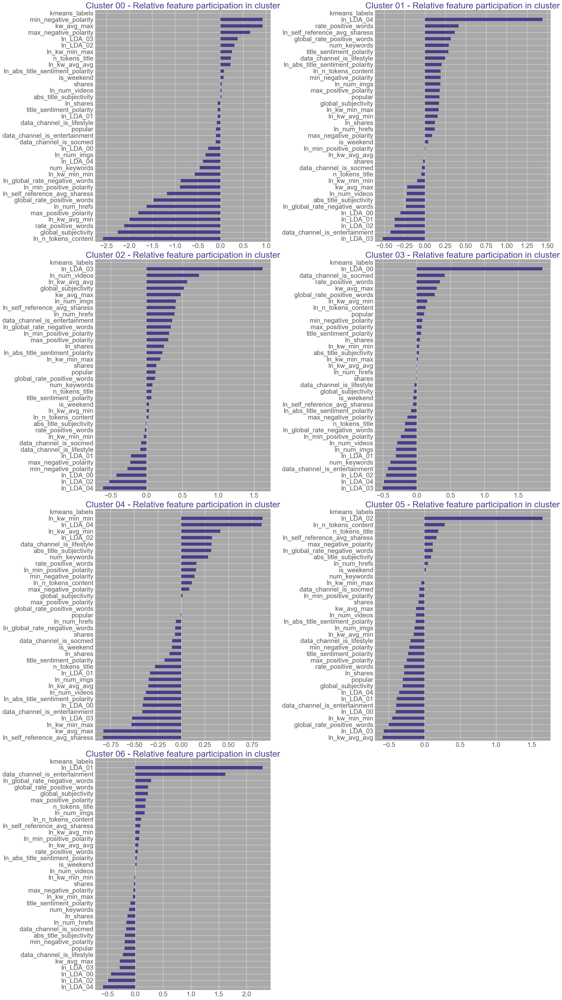

In [29]:
Image("./plots/kmeans/cluster_kmeans_cluster_barplots.png")

### SpectralClustering - Visualize  

* To evaluate the resulting 7 clusters from the spectral clustering, a similar approach is taken as was used above for the k-means evaulation :  

    - re-join the feature data set to the cluster identification regions from the spectral clustering analysis for comparison of the features with the mapped cluster labels  
    - construct visual interpretation aid of a 3-plot set for each feature as shown in below figures. Each 3-set of plots includes the following :  
        - left hand map is a spectrum map of that feature onto the t-SNE 2-D vector space, the color scale represents the magnitude of each point of the feature in that space,
        - the center plot is a set of box-whisker plots of the same feature, where each boxplot is associtaed to each of the cluster labels. In addition to the boxplots which include the quartile definitions as the box boundaries, the population mean in each cluster is represented on the boxplot chart in (small) white text.
        - the right hand map is the representation of the cluster labels - differentiatied by each color region - of the clusters as visualized in the t-SNE 2D space
        
   - the 3-plot set can be viewed together for each feature to understand how that feature's relative values are distributed across the clusters, and allows to visualize 
   - examples from 4 of the features (LDA_00, LDA_01, LDA_02, LDA_03, and LDA_04) are shown in the following set of plots (Figures XX --> XX_5)  
   
* These plots show the following relationships :  
    - LDA_00 high values are associate with Cluster 2.
    - LDA_01 high values are associate with Cluster 7.
    - LDA_02 high values are associate with Cluster 1.
    - LDA_03 high values are associate with Clusters 3 & 6.
    - LDA_04 high values are associate with Clusters 1, 4, & 5.
    
* Similarly, an observation about relative participation of each feature in each of the clusters was identified and used in the subsequent interpretations of the clusters.
   

***  

#### Fig X - LDA_00 distributions in SpectralClustering cluster space  

* Cluster 2 - associated to high values of LDA_00 (correlated to Business Channel)

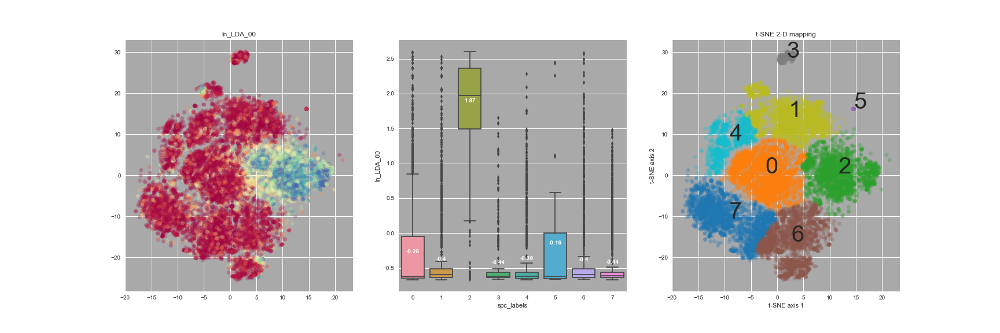

In [30]:
Image("./plots/spectral/cluster_spctrl_3way_preplx_100_ln_LDA_00.png")

***  

#### Fig X - LDA_01 distributions in SpectralClustering cluster space  

* Cluster 7 - associated to high values of LDA_01 (correlated to Entertainment Channel)

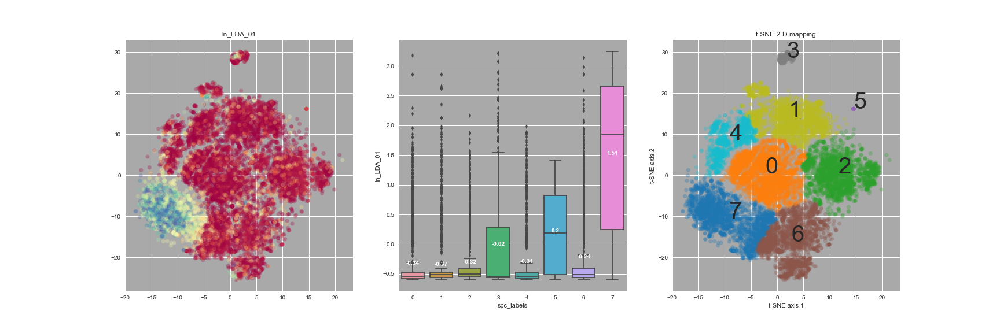

In [31]:
Image("./plots/spectral/cluster_spctrl_3way_preplx_100_ln_LDA_01.png")

***  

#### Fig X - LDA_02 distributions in SpectralClustering cluster space  

* Clusters 1 - associated to high values of LDA_02 (correlated to World Channel)

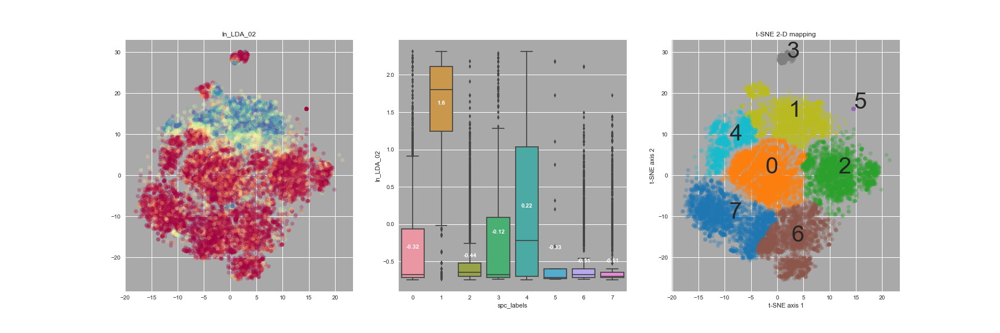

In [32]:
Image("./plots/spectral/cluster_spctrl_3way_preplx_100_ln_LDA_02.png")

***  

#### Fig X - LDA_03 distributions in SpectralClustering cluster space  

* Clusters 3 & 6 - associated to high values of LDA_03

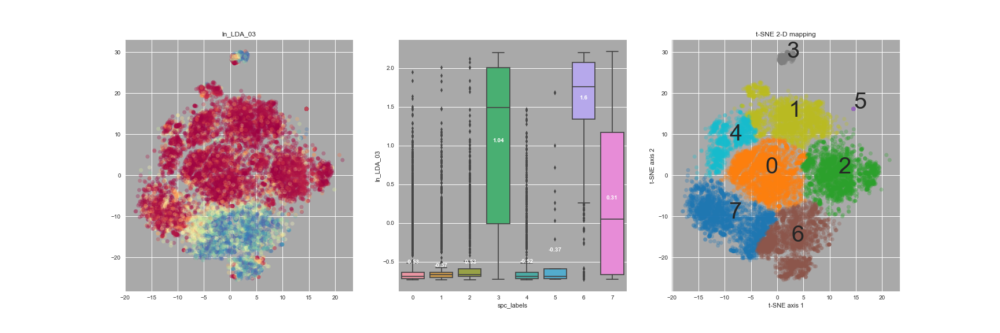

In [33]:
Image("./plots/spectral/cluster_spctrl_3way_preplx_100_ln_LDA_03.png")

***  

#### Fig X - LDA_04 distributions in SpectralClustering cluster space  

* Clusters 1, 4, & 5 - associated to high values of LDA_04 (correlated to Technology Channel)

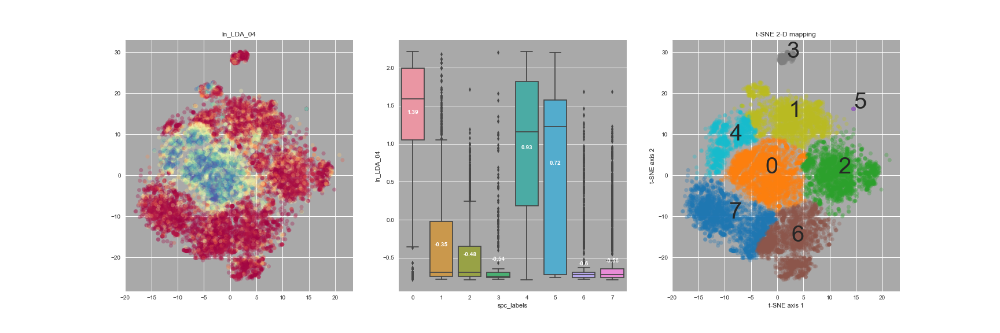

In [34]:
Image("./plots/spectral/cluster_spctrl_3way_preplx_100_ln_LDA_04.png")

- The 3-plot sets above aid in identifying the assocation of each feature relative to the cluster regions and 

To further understand the cluster relationships, an additional view is presented. For each cluster the mean value of each feature in that cluster was determined, the standard deviation of those means, and a z-score of each mean relative to other means in that cluster were compared. The goal was not to assess these z-scores for statistical signficantly different means, but rather as a method to identify in a consistent way the relative participation of each feature in each cluster. The goal is to identify the few most (both positively and negatively) impactful features in defining the cluster characteristics. The median of each cluster, or some other statistic, could have also been used for this purpose. For the clusters developed for this data set, means and medians provide essentially the same view of the major contributors to a cluster characterization.

The plots below show these distributions of means for each feature in each of the clusters developed from the above k-means application.

As an example, we can make the following observations of the clusters based on these plots (and a detailed examination of the underlying values in a data table)  

* Cluster 01  
    - LDA_04 (correlated to Technology Channel) is strongest definer
    - several references to _positive_ sentiment rank near the top contributors
    - All other LDA scores are negatively indicated in this cluster - there is a strong negative relationship to the other data channels (Business, Entertainment, World, and SocialMedia). In other words, this cluster is uniquely associated to the Technoglogy channel and also has appreciation for article content with stronger positive sentiments
    
* Cluster 04
    - LDA_04 and LDA_02 are strong participants in this cluster
        . LDA_04 is correlated to the Technology Channel
        . LDA_02 is correlated to the World Channel
        . 
    - Measures related to referencing other articles from within the mashable ecosystem (ln_self_reference_sharess)vare minimally used
    - Measures related to high use of keywords from within these articles is negatively associated to this cluster (kw_min_max and kw_avg_max)
    Thus, we can interpret this to be a cluster defined by an intersection or association of appreciation to World and Technolgy related content and with low reliance and interest on pursuing to other (even related) articles within the mashable site
    
Similary, an interpretation was completed for each cluster based on the relative measure of feature means distribution within each cluster.

As will be shown in subsequent sections, this exercise was repeated for each of the clustering methods deployed. A synopsis of relevant clusters from the overall analysis will be presented in the summary section.



***  

#### Fig X - Relative participation of each feature in each cluster

*** 

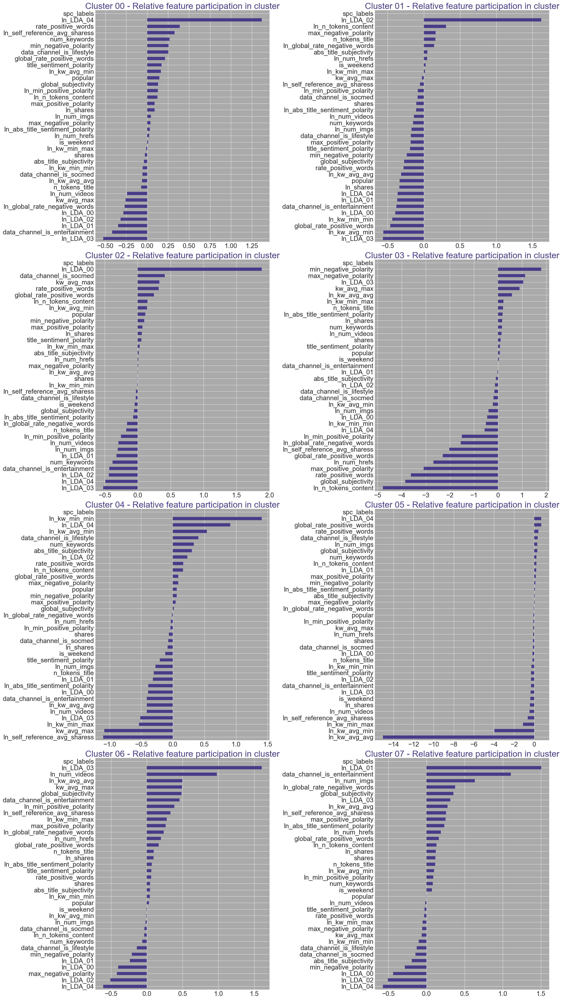

In [35]:
Image("./plots/spectral/cluster_spctrl_cluster_barplots_horizontal.png")

#### 6.3 Hierarchical clustering results

##### To evaluate the resulting clusters for each of the linkage method
1. Re-join the feature data set to the cluster identification regions from the method(ward,complete,average) analysis for comparison of the features with the mapped cluster labels
2. Construct visual interpretation aid of a 3-plot set for each feature as shown in below figures. Each 3-set of plots includes the following :  
    a. Left hand map is a <b>spectrum map</b> of that feature onto the t-SNE 2-D vector space, the color scale represents the magnitude of each point of the feature in that space,  
    b. The center plot is a set of <b>box-whisker</b> plots of the same feature, where each boxplot is associtaed to each of the cluster labels. In addition to the boxplots which include the quartile definitions as the box boundaries, the population mean in each cluster is represented on the boxplot chart in (small) white text.  
    b. The right hand map is the representation of the <b>cluster labels</b> - differentiatied by each color region - of the clusters as visualized in the t-SNE 2D space.  
 
The 3-plot set can be viewed together for each feature to understand how that feature's relative values are distributed across the clusters, and allows to visualize.

###### Feature importance 
###### a. ward

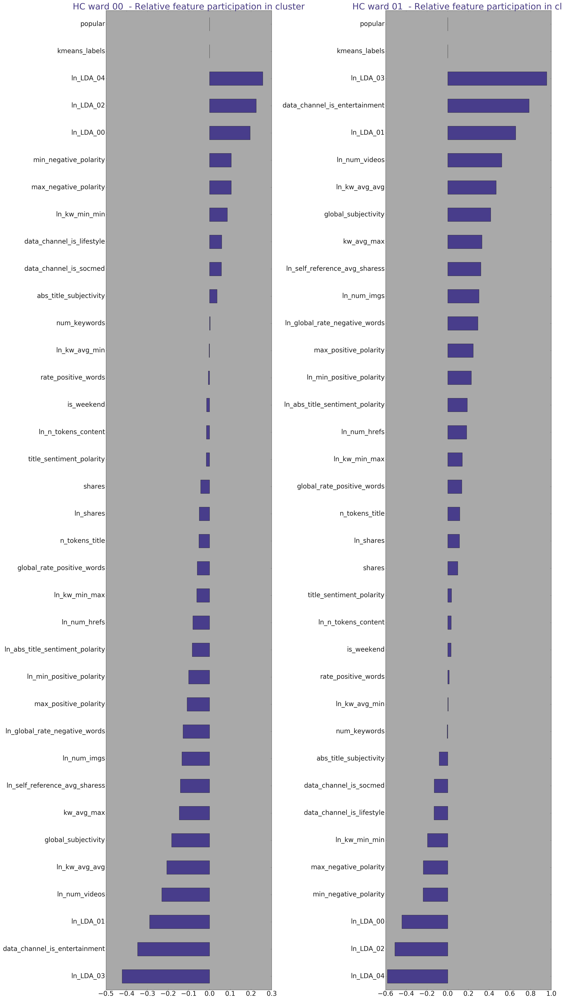

In [13]:
Image("plots/hierarchical/HC_ward_feature_importance.png")

#### b. complete

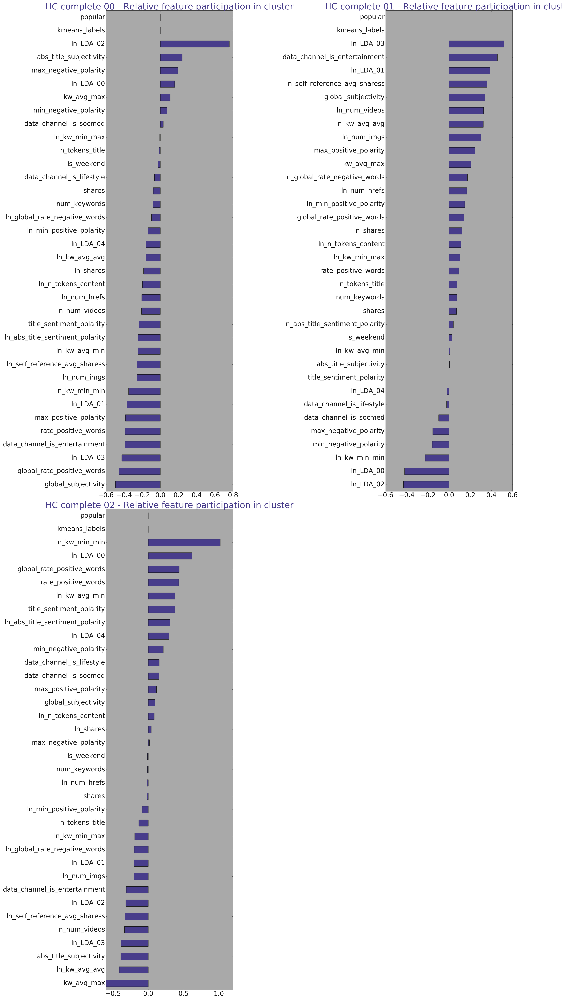

In [14]:
Image("plots/hierarchical/HC_complete_feature_importance.png")

#### c. average

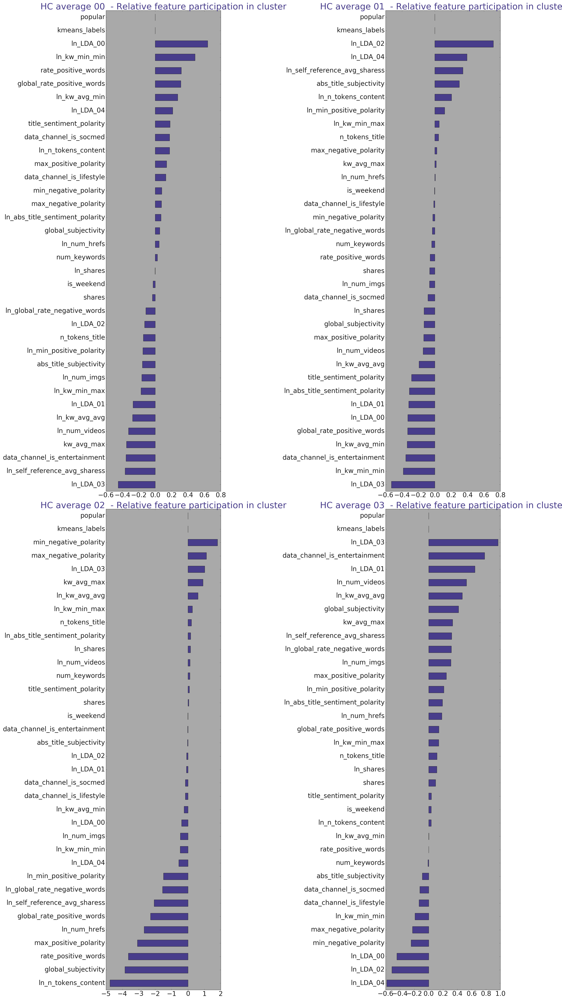

In [15]:
Image("plots/hierarchical/HC_average_feature_importance.png")

#### Based of feature importance, we will pick interesting features to visualize them in depth
###### LDA_00 for all 3 linkage methods:

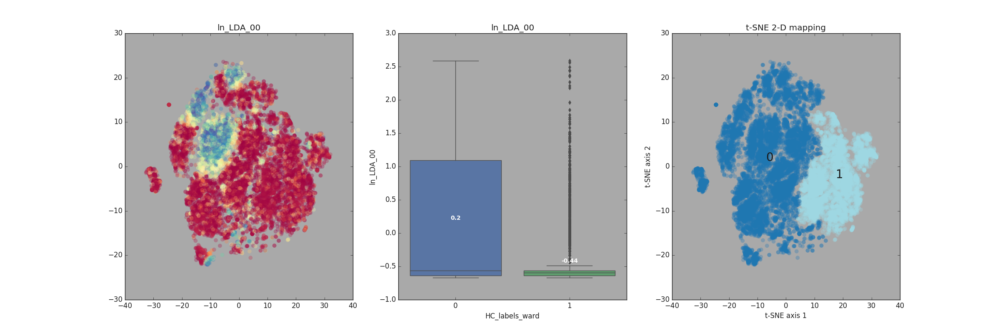

In [16]:
Image("./plots/hierarchical/cluster_HC_ward_3way_preplx_100__4clstrsln_LDA_00.png")

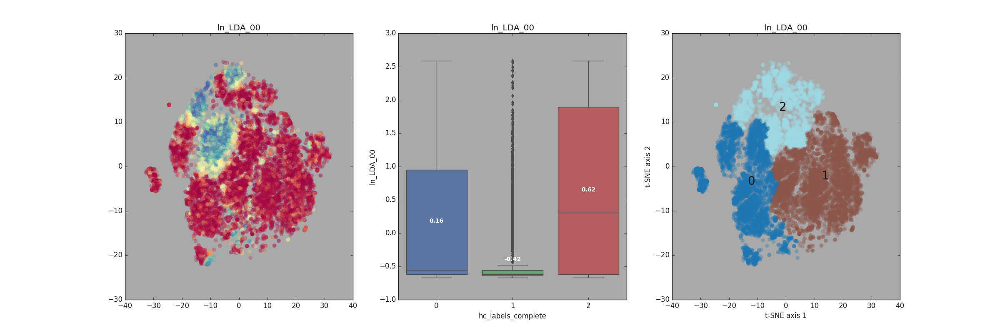

In [17]:
Image("./plots/hierarchical/cluster_HC_complete_3way_preplx_100__4clstrsln_LDA_00.png")

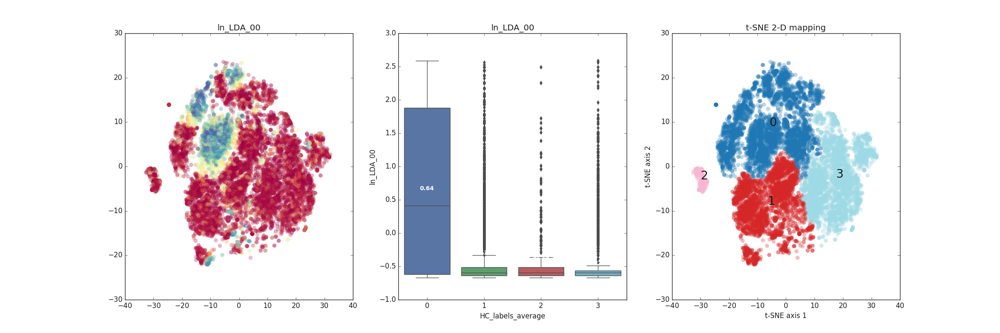

In [18]:
Image("./plots/hierarchical/cluster_HC_average_3way_preplx_100__4clstrsln_LDA_00.png")

#### b. LDA_01 for all 3 linkage methods:

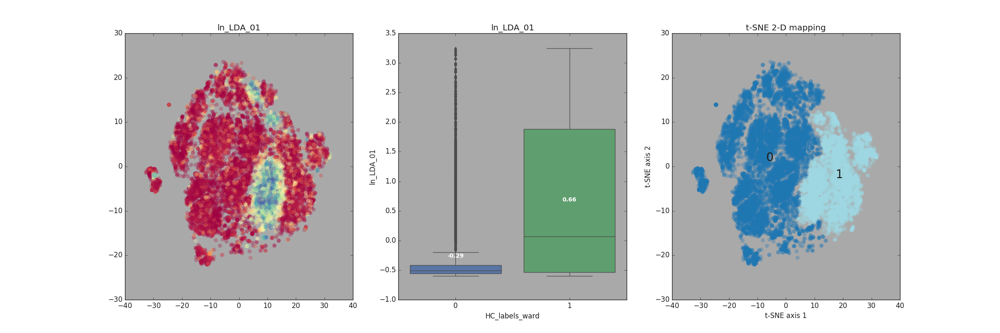

In [19]:
Image("./plots/hierarchical/cluster_HC_ward_3way_preplx_100__4clstrsln_LDA_01.png")

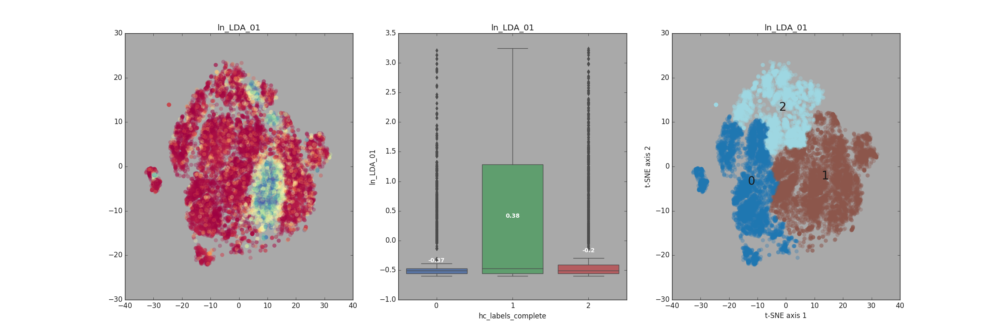

In [20]:
Image("./plots/hierarchical/cluster_HC_complete_3way_preplx_100__4clstrsln_LDA_01.png")

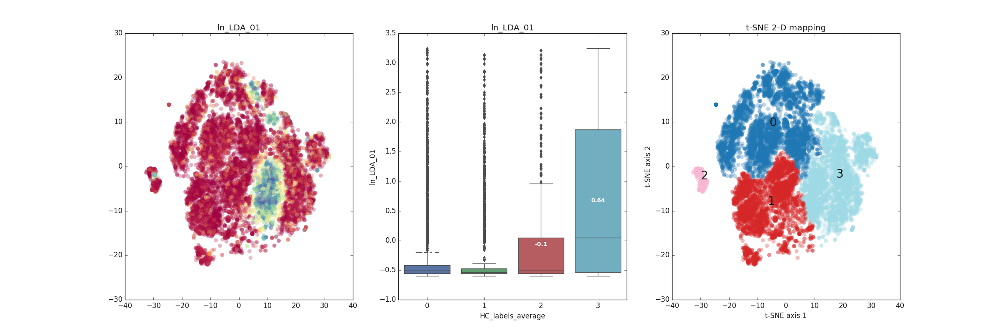

In [21]:
Image("./plots/hierarchical/cluster_HC_average_3way_preplx_100__4clstrsln_LDA_01.png")

#### a. LDA_02 for all 3 linkage methods:

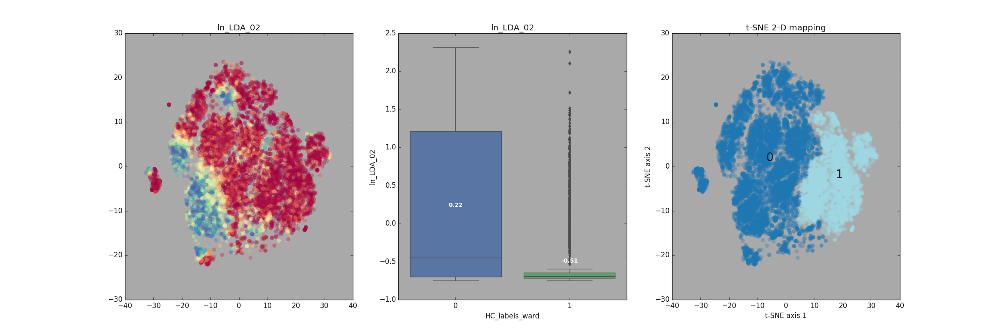

In [25]:
Image("./plots/hierarchical/cluster_HC_ward_3way_preplx_100__4clstrsln_LDA_02.png")

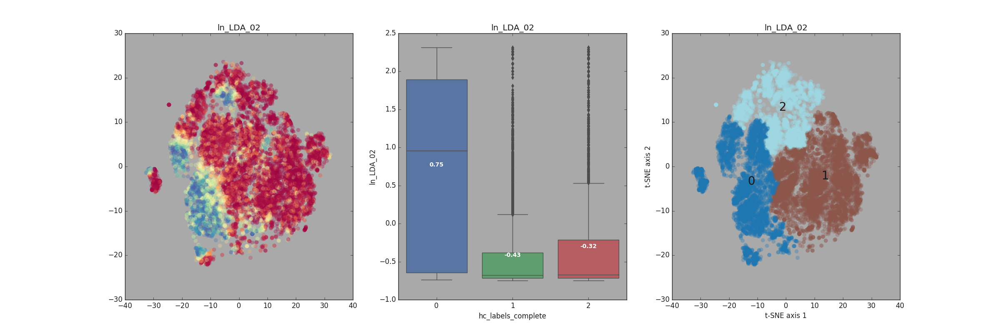

In [26]:
Image("./plots/hierarchical/cluster_HC_complete_3way_preplx_100__4clstrsln_LDA_02.png")

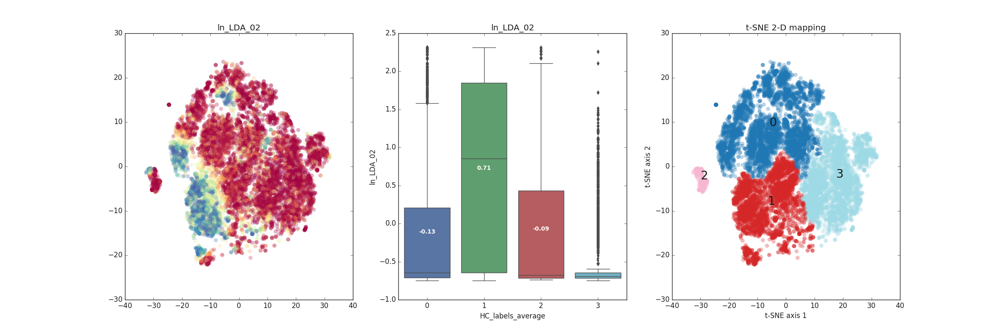

In [27]:
Image("./plots/hierarchical/cluster_HC_average_3way_preplx_100__4clstrsln_LDA_02.png")

#### a. LDA_03 for all 3 linkage methods:

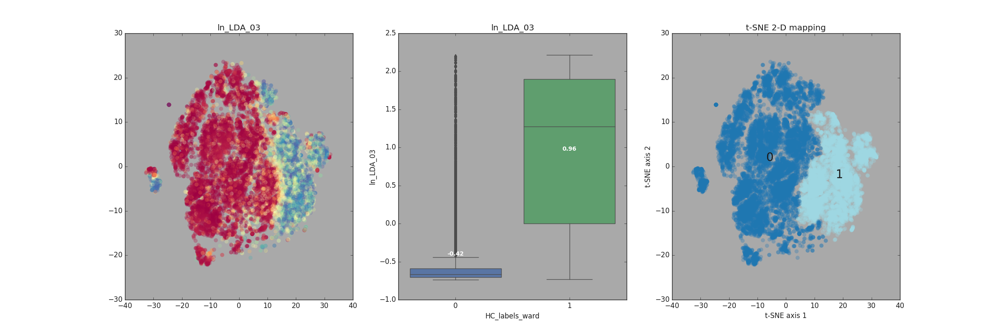

In [28]:
Image("./plots/hierarchical/cluster_HC_ward_3way_preplx_100__4clstrsln_LDA_03.png")

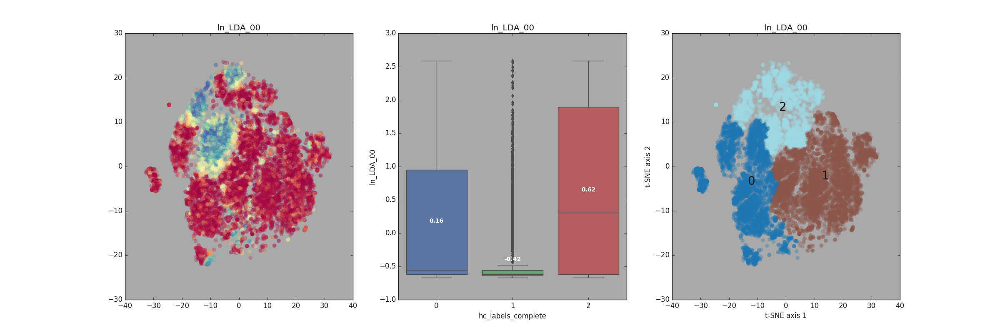

In [29]:
Image("./plots/hierarchical/cluster_HC_complete_3way_preplx_100__4clstrsln_LDA_00.png")

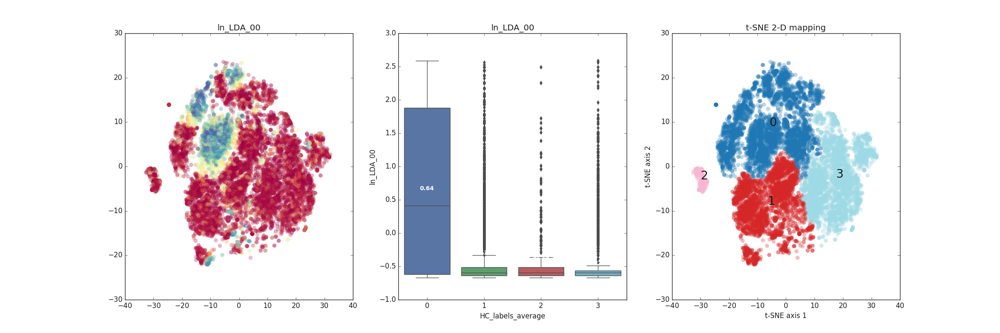

In [30]:
Image("./plots/hierarchical/cluster_HC_average_3way_preplx_100__4clstrsln_LDA_00.png")

#### a. LDA_04 for all 3 linkage methods:

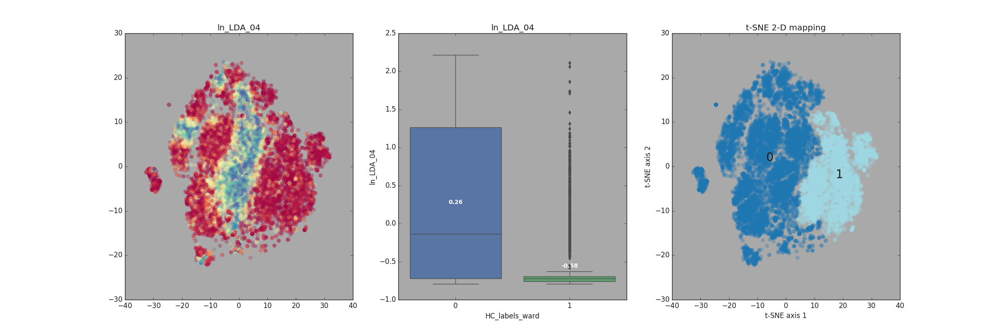

In [31]:
Image("./plots/hierarchical/cluster_HC_ward_3way_preplx_100__4clstrsln_LDA_04.png")

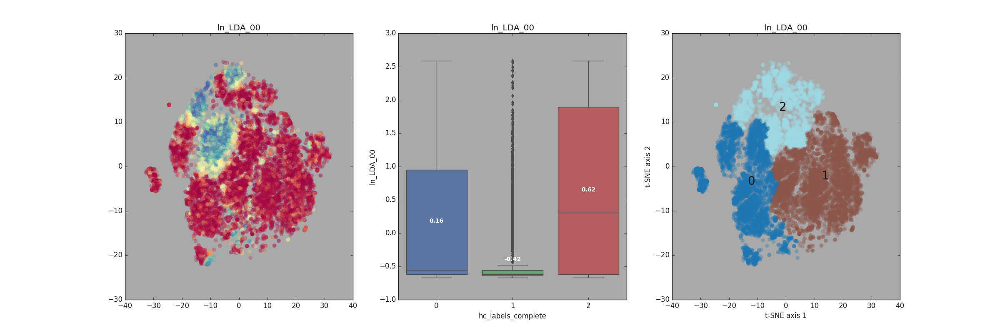

In [32]:
Image("./plots/hierarchical/cluster_HC_complete_3way_preplx_100__4clstrsln_LDA_00.png")

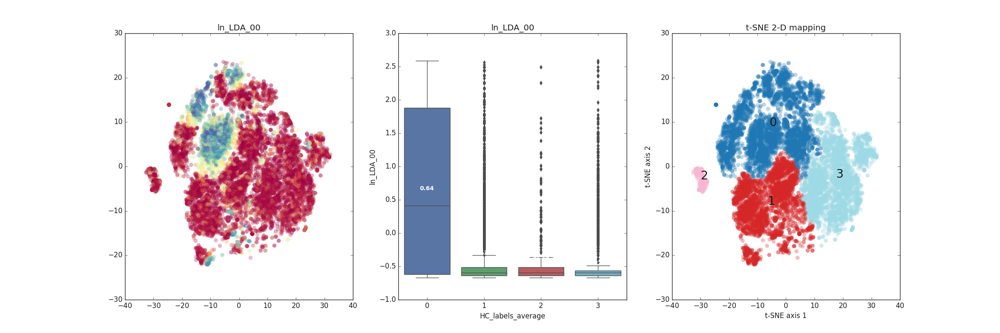

In [33]:
Image("./plots/hierarchical/cluster_HC_average_3way_preplx_100__4clstrsln_LDA_00.png")

###### a. data_channel_is_entertainment  for all 3 linkage methods:
<table>
  <tr>
  <td><img src="plots/hierarchical/cluster_HC_ward_3way_preplx_100__4clstrsdata_channel_is_entertainment.png"></td></tr>
  <tr><td><img src="plots/hierarchical/cluster_HC_complete_3way_preplx_100__4clstrsdata_channel_is_entertainment.png"></td></tr>
    <tr><td><img src="plots/hierarchical/cluster_HC_average_3way_preplx_100__4clstrsdata_channel_is_entertainment.png"></td></tr>
</table>

###### a. num of images for all 3 linkage methods:
<table>
      <tr>
        <td><img src="plots/hierarchical/cluster_HC_ward_3way_preplx_100__4clstrsln_num_imgs.png"></td></tr>
        <tr><td><img src="plots/hierarchical/cluster_HC_complete_3way_preplx_100__4clstrsln_num_imgs.png"></td></tr>
        <tr><td><img src="plots/hierarchical/cluster_HC_average_3way_preplx_100__4clstrsln_num_imgs.png"></td></tr>
</table>

###### number of videos for all 3 linkage methods:
<table>
      <tr>
        <td><img src="plots/hierarchical/cluster_HC_ward_3way_preplx_100__4clstrsln_num_videos.png"></td></tr>
        <tr><td><img src="plots/hierarchical/cluster_HC_complete_3way_preplx_100__4clstrsln_num_videos.png"></td></tr>
        <tr><td><img src="plots/hierarchical/cluster_HC_average_3way_preplx_100__4clstrsln_num_videos.png"></td></tr>
</table>

###### global subjectivity for all 3 linkage methods:
<table>
      <tr>
        <td><img src="plots/hierarchical/cluster_HC_ward_3way_preplx_100__4clstrsglobal_subjectivity.png"></td></tr>
        <tr><td><img src="plots/hierarchical/cluster_HC_complete_3way_preplx_100__4clstrsglobal_subjectivity.png"></td></tr>
        <tr><td><img src="plots/hierarchical/cluster_HC_average_3way_preplx_100__4clstrsglobal_subjectivity.png"></td></tr>
</table>

###### global_rate_positive_words for all 3 linkage methods:
<table>
<tr>
<td><img src="plots/hierarchical/cluster_HC_ward_3way_preplx_100__4clstrsglobal_rate_positive_words.png"></td></tr>
<tr><td><img src="plots/hierarchical/cluster_HC_complete_3way_preplx_100__4clstrsglobal_rate_positive_words.png"></td></tr>
<tr><td><img src="plots/hierarchical/cluster_HC_average_3way_preplx_100__4clstrsglobal_rate_positive_words.png"></td></tr>
</table>

###### title_sentiment_polarity for all 3 linkage methods:
<table>
<tr>
<td><img src="plots/hierarchical/cluster_HC_ward_3way_preplx_100__4clstrstitle_sentiment_polarity.png"></td></tr>
<tr><td><img src="plots/hierarchical/cluster_HC_complete_3way_preplx_100__4clstrstitle_sentiment_polarity.png"></td></tr>
<tr><td><img src="plots/hierarchical/cluster_HC_average_3way_preplx_100__4clstrstitle_sentiment_polarity.png"></td></tr>
</table>

###### max_positive_polarity for all 3 linkage methods:
<table>
<tr>
<td><img src="plots/hierarchical/cluster_HC_ward_3way_preplx_100__4clstrsmax_positive_polarity.png"></td></tr>
<tr><td><img src="plots/hierarchical/cluster_HC_complete_3way_preplx_100__4clstrsmax_positive_polarity.png"></td></tr>
<tr><td><img src="plots/hierarchical/cluster_HC_average_3way_preplx_100__4clstrsmax_positive_polarity.png"></td></tr>
</table>

###### data_channel_is_lifestyle for all 3 linkage methods:
<table>
<tr>
<td><img src="plots/hierarchical/cluster_HC_ward_3way_preplx_100__4clstrsdata_channel_is_lifestyle.png"></td></tr>
<tr><td><img src="plots/hierarchical/cluster_HC_complete_3way_preplx_100__4clstrsdata_channel_is_lifestyle.png"></td></tr>
<tr><td><img src="plots/hierarchical/cluster_HC_average_3way_preplx_100__4clstrsdata_channel_is_lifestyle.png"></td></tr>
</table>

###### ln_self_reference_avg_shares for all 3 linkage methods:
<table>
<tr>
<td><img src="plots/hierarchical/cluster_HC_ward_3way_preplx_100__4clstrsln_self_reference_avg_sharess.png"></td></tr>
<tr><td><img src="plots/hierarchical/cluster_HC_complete_3way_preplx_100__4clstrsln_self_reference_avg_sharess.png"></td></tr>
<tr><td><img src="plots/hierarchical/cluster_HC_average_3way_preplx_100__4clstrsln_self_reference_avg_sharess.png"></td></tr>
</table>

<a name='intro'></a>  
<a href='#toc'>Return to Table of Contents</a>  

<a name='me.01.t4'></a>

<font color = "blue" size = 6>Modeling and Evaluation 4: Summarize the Ramifications</font>

# TODO 7.1, 7.2 summarize 

### ME.4.1 - K-Means Summary

After review of the relative positive and negative participation of the features in the clusters, we identified that there are some consistent themes that support a synopsis / summarization of the salient characteristics and identifying contrasting characteristics of the clusters in a way that supports the business interests.

1. Almost all clusters can be associated as having very strong participation of the Latent Dirichlet allocation measures (LDAA_xx). We identified from previous analyses that these LDA scores are also highly correlated to specific Channels in the mashable network. As a starting point, then, we identify the clusters to an associated data channel based on the highest LDA participation and its corresponding data channel.
2. It is interesting from the business perspective to understand the relative participation of images and videos in the cluster content, as that is contrasting across the clusters.
3. Clusters can be uniquely associated to one data channel or can be cross-channel characterized. We characterize the relative strength of the alternate channels within the context of the prime channel for each cluster.
4. There is some interest in understanding how content length contributes to each cluster's characteristics, so the measures associated to article length are included comparative analysis.
5. The relationship of content to the use of other resources within the mashable ecosystem shows some measurable contrasts and is also relevant to the understand if content supports retention of a user within the mashable site. Measures that identify 'within mashable' references are identified for each cluster.
6. Although the cluster analysis did not identify strong associations between the clusters and relative strength of social media shares of the readers, it is interesting to identify the relative scale of shares / popularity across the clusters. This is shown not to be predictive across the clusters, but the relative trends are still characterized for reference.

The below table indicates for each cluster the relative strength (positive and negative) of these characteristics in defining a cluster composition. 

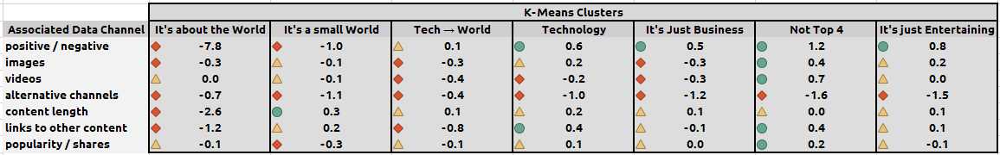

In [36]:
Image("./plots/kmeans_cluster_summary.png")

### ME.4.2 - Spectral Clustering Summary

Similar to the above summary regarding characterization of K-Means .

1. Almost all clusters can be associated as having very strong participation of the Latent Dirichlet allocation measures (LDAA_xx). We identified from previous analyses that these LDA scores are also highly correlated to specific Channels in the mashable network. As a starting point, then, we identify the clusters to an associated data channel based on the highest LDA participation and its corresponding data channel.
2. It is interesting from the business perspective to understand the relative participation of images and videos in the cluster content, as that is contrasting across the clusters.
3. Clusters can be uniquely associated to one data channel or can be cross-channel characterized. We characterize the relative strength of the alternate channels within the context of the prime channel for each cluster.
4. There is some interest in understanding how content length contributes to each cluster's characteristics, so the measures associated to article length are included comparative analysis.
5. The relationship of content to the use of other resources within the mashable ecosystem shows some measurable contrasts and is also relevant to the understand if content supports retention of a user within the mashable site. Measures that identify 'within mashable' references are identified for each cluster.
6. Although the cluster analysis did not identify strong associations between the clusters and relative strength of social media shares of the readers, it is interesting to identify the relative scale of shares / popularity across the clusters. This is shown not to be predictive across the clusters, but the relative trends are still characterized for reference.

The below table indicates for each cluster the relative strength (positive and negative) of these characteristics in defining a cluster composition. 

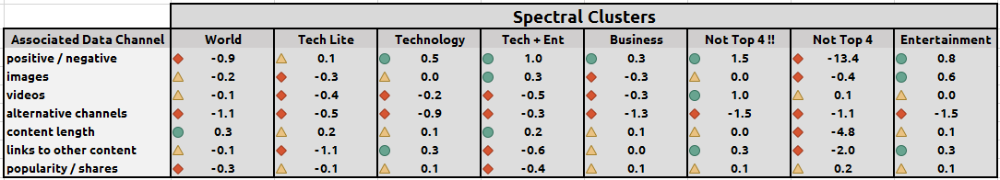

In [37]:
Image("./plots/spectral_cluster_summary.png")

#### 7.3 hierarchical clustering: Summarize the ramifications

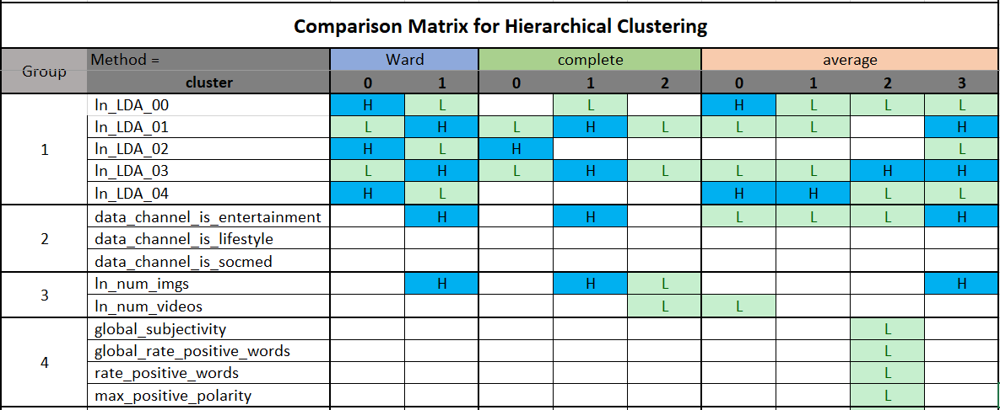

In [23]:
Image("./plots/hierarchical/HC_comparisonMatrix.png")

For our analysis, we will look into each of the hierarchical models and compare the behaviour of features under each type. We will start by looking at the <b>comparison matrix</b>.

1. LDA00 thru LDA04:
We can see that overall LDA00 thru LDA04 are highly impactful in creating clusters for all 3 types of models. What is interesting here is LDA_04, Ward and average methods used this feature values to distinguish clusters but complete spread it evenly betweem all 3 clusters. Looking at the LDAs, we can clearly see that 'Ward' makes high and low value clusters.<br><br>

2. data_channel (Entertainment, social media, lifestyle):
Among all data_channels, Entertainment, Lifestyle and Social media features are in our final list of features. entertainment has made an impact on all 3 models in forming clusters. Most entertainment values have formed a strong cluster of its own. Cluster 1 of 'ward', cluster 1 of 'complete' and culster 4 of 'average' can be called high-entertainment cluster. Among the 3, entertain ment has huge data with 7K mashable links while Social media and lifestyle has only around 2k.<br><br> 

3.  Numbers like images, videos:
These features are particularly interesting as they behave differently for each of the models. while low videos form a cluster in complete and average, ward method shows no deviation. The images however form a cluster based on the images in an article. Ward and complete have formed a cluster with high number of images. Also, a high number of images also forms strong bond with entertainment<br><br>

4. Global appeal and postivity: ( global_subjectivity, global_rate_positive_words, rate_positive_words, max_positive_polarity)
These set of features are interesting to note as it shows strongly impactful in 'average' but has no impact in other two methods. The 'average' method formed cluster 2 which could be named as low global appeal and low positive words. This is the same cluster which was low on LDA_00 and LDA_04.<br><br>

5. Each method by itself:<br>
    a. <b>ward</b>: Just 2 clusters, with LDAs being major factors, number of images and data_channel entertainment. Cluster 1 is high images and entertainment, there is strong visual importance here. cluster 0 is low image count and ????

    b. <b>complete</b>: 3 clusters, cluster 1 is strong on LDA_01, LDA_03, entertainment and high image count. This is somewhat similar to cluster 1 of ward for high values. While complete forms a different cluster, cluster 2 for low values of these features. while cluster 0 is mostly LDA_02 and low values of LDA_01, LDA_03.
    
    c. <b>average</b>: formed 4 clusters. Cluster 3 is high on LDA_01, LDA_03, images and entertainment. this is consistent with other methods as well. Cluster 0 strong on LDA_00 and LDA_04 and away from entertainment and videos. Cluster 2 seems a very small cluster mostly of LDA_03 values with low entertainment values.<br><br>
    
<b><u>Patterns</u></b>:<br>
    LDA_01, LDA_03, entertainment and imgaes are consistently together. Clearly certain set of vocabulary related to entertainment are found in LDA_01 and LDA_03. Putting this together with number of shares, the high shares under entertainment like <i>"McDonalds Kills Site That Advised Employees to Eat Healthy Meals", "What to Do With Your New Xbox one" </i> have high count of images, more than 10,<br><br>
    while low shares under entertainment like <i>"11 TV Characters Older Than the Class of 2018", "Hasbro Games Show Signs of Life in iPad World"</i> show 1 to none images.
    


Notes:
The patterns observed here is specific to the data we took to analyze. We cannot extrapolate these behavior to future mashable data.
    

#### 7.4 Clustering Methods Comparison : Summarize the ramifications

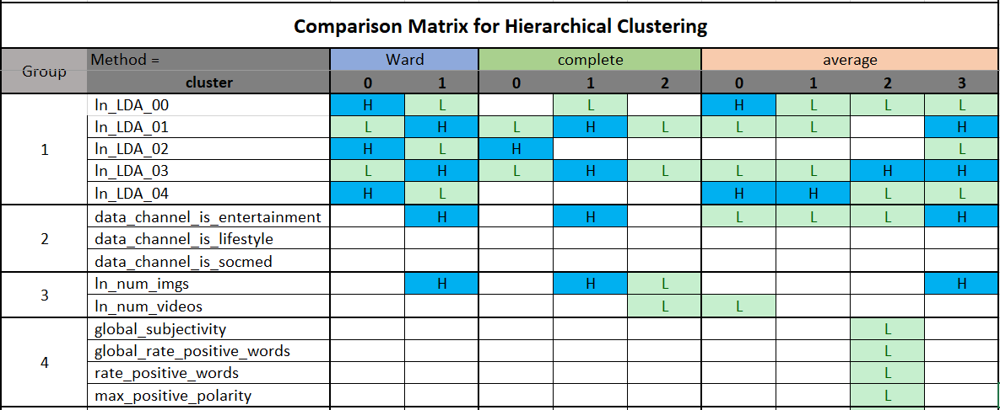

In [24]:
Image("./plots/hierarchical/HC_comparisonMatrix.png")

#### Analysis of Clusters  


After review of the relative positive and negative participation of the features in the clusters, we identified that there are some consistent themes that support a synopsis / summarization of the salient characteristics and identifying contrasting characteristics of the clusters in a way that supports the business interests.

1. Almost all clusters can be associated as having very strong participation of the Latent Dirichlet allocation measures (LDAA_xx). We identified from previous analyses that these LDA scores are also highly correlated to specific Channels in the mashable network. As a starting point, then, we identify the clusters to an associated data channel based on the highest LDA participation and its corresponding data channel.  
2. It is interesting from the business perspective to understand the relative participation of images and videos in the cluster content, as that is contrasting across the clusters.  
3. Clusters can be uniquely associated to one data channel or can be cross-channel characterized. We characterize the relative strength of the alternate channels within the context of the prime channel for each cluster.  
4. There is some interest in understanding how content length contributes to each cluster's characteristics, so the measures associated to article length are included comparative analysis.  
5. The relationship of content to the use of other resources within the mashable ecosystem shows some measurable contrasts and is also relevant to the understand if content supports retention of a user within the mashable site. Measures that identify 'within mashable' references are identified for each cluster.  
6. Although the cluster analysis did not identify strong associations between the clusters and relative strength of social media shares of the readers, it is interesting to identify the relative scale of shares / popularity across the clusters. This is shown not to be predictive across the clusters, but the relative trends are still characterized for reference.  

The below table indicates for each cluster the relative strength (positive and negative) of these characteristics in defining a cluster composition. The table also aligns the similar composition clusters between the clusters developed by the K-Means and the SpectralClustering methods. The comparison between the clustering methods are grouped vertically in the table so that a visual comparison can be made between similarly related channels E.g., the K-Means clusters associated to the World Data Channel are vertically aligned with the SpectralClustering cluster that is also associated to the World Data Channel. From the table we can observe that the K-Means and SpectralClustering developed clusters generally provide the same view of the cluster composition at this business level view. 



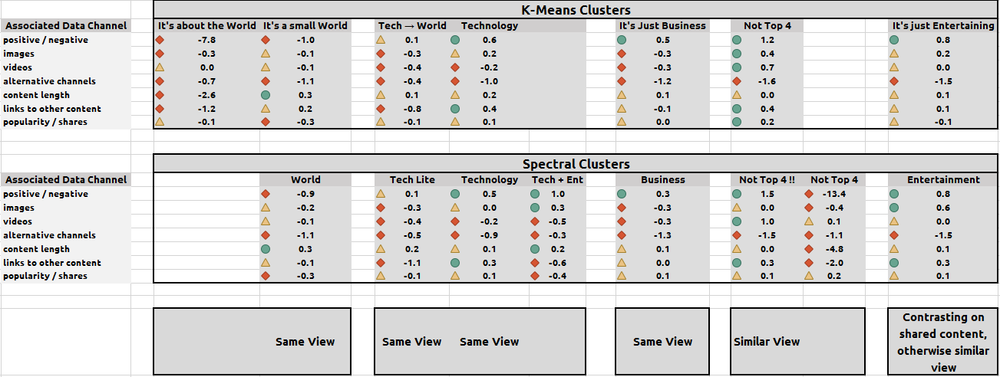

In [38]:
Image("./plots/cluster_comparison.png")

<a name='ref.01'></a>  
<a href='#toc'>Return to Table of Contents</a>  

### References

1. <a name='fn1'></a> https://www.analyticsvidhya.com/blog/2017/01/t-sne-implementation-r-python/  
2. <a name='fn2'></a> https://lvdmaaten.github.io/tsne/  

<a name='dp.01.t1'></a>

<font color = "blue" size = 6> 8. Deployment</font>

***  
Be critical of your performance and tell the reader how you current model might be usable by other parties. 
Did you achieve your goals? If not, can you reign in the utility of your modeling?
How useful is your model for interested parties (i.e., the companies or organizations that might want to use it)? 
How would your deploy your model for interested parties?
What other data should be collected? 
How often would the model need to be updated, etc.?

## __Deployment__  

***  

#### usablility 
The culster analysis of this project is to understand how certain features behave. How we could use the analysis results to compare it to popularity.

We have for purpose of comparison 4 categories of shares
Viral
very popular
good
??



how data gets clustered into groups and analyse these groups and the features 

features form groups and which features
 
this model will be valuable to business to make decisions based on clusters identified.

we also have compared clusters and shares to identify patterns

#### goal
Our goal for the project was to 

####  usefulness

The cluster analysis model we have built would be converted into a report. This report will contain analysis of features that were used to form clusters and how they behave.
---- presented to the managment with results ---

#### deployment


Since this is not a trained model the output


#### other data
#### updates


#### Usefulness  ##

The usefulness of this model is to provide guidance as to which articles are to be published on the mashable.com web-site. One facet of Mashable's business model is to generate revenue by selling advertising and sponsored content on the mashable.com web-site. The value of the site to advertisers, and the revenue stream that can be protected for mashable, can be measured by the number of articles that mashable readers share with their on-line social media network. The value of this classification model is to identify the site content with higher likelihood of being popularly shared within the the target audience. 



#### Measurement of model value    ##
 
A way to measure the model's value is by monitoring the success of the prediction model in terms of increasing social media shares from mashable published articles. Since there can be many (very many !) factors influencing the popularity (number of shares) of articles that are beyond the applicability scope of the model, it is recommended that the value measurement be assessed by controlled A/B releases of content that is decided by current methods, side-by-side, with content that is recommended with this classification. By using a side-by-side A/B evaluation, the effectiveness of the classification model for improving content recommendations can be credibly assessed.


#### Deployment method / external data support    ##
 
 The current vision for deployment of the model includes these elements :  
 - a web-based user interface in which the user (the article author or other proposer) can deposit the article (title, content, embedded images and videos) in similar fashion as DropBox or other similar media-sharing file servers  
 - a parsing / feature extraction machine deployed at the shared file server site  
     - the model requires the extraction of several explanatory variables (feature extraction) from the content of the article in order to evaluate the article's popularity score in the model  
         - among the features to be extracted from the article as model inputs are the following :  
             * key-word statistics, positive and negative sentiment counts, LDA_00 --> LDA_04 scores, number of images and number of videos, sentiment polarity based on title, related hyperlink references  
         - a feature extraction machine will be deployed at the file server site to process the article content and provide the model inputs  
         - in addition, another element of the deployment is to assign the article to an appropriate data channel (e.g., Social Media, Technology, Business). this will also be an element deployed on the file server site. the text and title will be processed through a text-mining approach to evaluate the appropriate data channel.  
         
  - once the key features have been developed from the text processing machines, then all of the inputs for the classification model are available and can be executed  
  
  - the concept of the deployment is :  
    * the article is uploaded to the submittal site,  
    * the feature extraction machine is launched, then  
    * the popularity classification model is executed, and  
    * the recommendation to publish or not to publish is provided to the mashable content editor.  
    * the execution time associated to this activity is anticipated to be real-time, within less than a few seconds.  
    
  - the goal of the application is that the article, with only some minimal contextual information (requested publication date, author contact information) is sufficient to provide a __publish / no-publish recommendation__ to the content editor;  
  - the goal is that there is no need for external data gathering to feed the model in the production environment  
  
 
#### Model Updates    ##

 - this model is intended to estimate the _mashable_ readers' perceptions of what is interesting and relevant to share with their social media network  
 - although the model's basic input features are attempting to capture and use elements that have a certain temporal durability (positive and negative sentiments, domain segregation of vocabulary, hyper-link reference counts) the fact remains that what is popular in this moment is an ever-evolving situation. Because of that, the recommendation is that, at the initial deployment phases, the model characteristics be updated on a monthly basis. Monitoring for evolution of the model charactersitic changes will provide relevant information as to the frequency of updates going forward - either more frequent or less frequent.  
 - longer term, the survivability of this model will be dependent on the ability to deploy this model in a manner that can incorporate reinforcement learning methods. the rapidly evolving nature of what is interesting or not interesting to contemporary society is the heart of the 

<a name='ref.01'></a>  
<a href='#toc'>Return to Table of Contents</a>  

<a name='ew.01.t1'></a>  
<font color="blue" size=6>9. Exceptional work </font>

<a name='ref.01'></a>  
<a href='#toc'>Return to Table of Contents</a>  

<a name='cb.01.t1'></a>  
<font color="blue" size=6>10. Link to code </font>